# Situational Awareness via Computer Vision: Integrating People Counting and Facial Emotion Recognition

- **Project Title:** People Counting and Emotion Recognition from Images
- **Team Number:** Group 12
- **Team Members:**
	-	Manoj Nair
	-	Tamayi Mlanda


The project is divided into two technical pipelines:

1.  **Object Detection:** Training YOLOv8 to detect and count people.
2.  **Image Classification:** Training a ResNet model (Transfer Learning) to recognize emotions on faces.
3.  **Integration:** A final inference script that combines both.

-----






# Phase 1: Project Selection & Setup



## 1.1 Problem Definition

  * **What is the problem you are going to solve?**  
    We are addressing the need for automated situational awareness. The problem involves two distinct tasks: quantification (how many people are in a space) and qualitative analysis (what is the emotional state of these individuals). We aim to build a system that takes a raw image and outputs a count of individuals while simultaneously assessing the "mood" of the scene by analyzing facial expressions.
  * **Why does the problem need to be solved?**  
    Manual monitoring of crowds or customer interactions is labor-intensive and not scalable. Automating this solves issues in various domains:
      * **Retail:** Understanding store occupancy vs. customer satisfaction.
      * **Safety:** Crowd counting for occupancy limits.
      * **Security:** Detecting distress (fear/anger) in surveillance feeds.
  * **What aspect of the problem will a computer vision algorithm solve?**  
    Computer Vision (CV) serves as the core sensor. We utilize **Object Detection (YOLO)** to localize and count human instances (spatial reasoning) and **Convolutional Neural Networks (CNNs)** to extract facial features and classify them into emotional categories (pattern recognition).

-----

# Phase 2: Environment & Data Setup


## Step 2.1: Library Installation

This block installs the necessary libraries.

In [1]:
from google.colab import drive
drive.mount('/content/drive')

#!cp -r "/content/drive/MyDrive/YOLO_People_Detection/" "/content/results/face_detection_l4"
#!cp "/content/drive/MyDrive/YOLO_People_Detection/best_model.pt" "/content/results/face_detection_l4/weights/best.pt"

# Install required packages
!pip install ultralytics roboflow opencv-python matplotlib
!pip install torch torchvision



Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [47]:
import os
import shutil
import zipfile
import numpy as np
import pandas as pd
import cv2
import matplotlib.pyplot as plt
from ultralytics import YOLO
import torch
from torch import nn
from torchvision.datasets import ImageFolder
from torchvision import transforms, models
from torch.utils.data import DataLoader
import torch.nn as nn
import torch.optim as optim
from collections import Counter
import random
from PIL import Image, ImageDraw
import PIL
import ultralytics
from pathlib import Path
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, BatchNormalization
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array
from tensorflow.keras.applications import VGG16
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam


# Phase 3: Object Detection: People in Images

## Step 3.1: Download and Prepare People Detection Dataset

People Detection Dataset: https://www.kaggle.com/datasets/adilshamim8/people-detection


The dataset is in Pascal VOC format, and needs to be converted to YOLO format.

In [3]:
# Downloading and unzipping the dataset
!mkdir -p /content/datasets
!mkdir -p /content/datasets/people_detection

!curl -L -o /content/datasets/people_detection.zip https://www.kaggle.com/api/v1/datasets/download/adilshamim8/people-detection

!unzip -o -q /content/datasets/people_detection -d /content/datasets/people_detection/

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
100 1990M  100 1990M    0     0   229M      0  0:00:08  0:00:08 --:--:--  207M


## Step 3.2: EDA: View the annotations



Training Dataset Annotations

In [4]:
df = pd.read_csv("/content/datasets/people_detection/train/train/_annotations.csv")
df.head()

,filename,width,height,class,xmin,ymin,xmax,ymax
0,2008_003132_jpg.rf.92f6223defec4f57f2d7b9cfa28...,500,375,person,219,98,269,283
1,2008_003132_jpg.rf.92f6223defec4f57f2d7b9cfa28...,500,375,person,114,124,155,263
2,2008_003132_jpg.rf.92f6223defec4f57f2d7b9cfa28...,500,375,person,43,139,98,340
3,004574_jpg.rf.7c8cea69d7be45f58febcede26ef0c6e...,500,333,person,145,118,229,333
4,004574_jpg.rf.7c8cea69d7be45f58febcede26ef0c6e...,500,333,person,285,105,349,329


Test Dataset Annotations

In [5]:

df = pd.read_csv("/content/datasets/people_detection/test/test/_annotations.csv")
df.head()



,filename,width,height,class,xmin,ymin,xmax,ymax
0,0002640_jpg.rf.a1f2d386da1e4821651f9dec0cf5254...,1280,964,person,165,511,217,642
1,2007_006841_jpg.rf.cdc00183ebc2771e932eb4f907e...,500,316,person,385,105,435,283
2,2007_006841_jpg.rf.cdc00183ebc2771e932eb4f907e...,500,316,person,488,117,499,215
3,2008_002523_jpg.rf.0504a335ef96ee9f9ac5153b237...,500,375,person,232,10,369,180
4,2007_004065_jpg.rf.99a8c0f81203b9368f6938238b1...,500,375,person,451,187,474,244


Validation Dataset Annotations

In [6]:
df = pd.read_csv("/content/datasets/people_detection/valid/valid/_annotations.csv")
df.head()

,filename,width,height,class,xmin,ymin,xmax,ymax
0,BSMT1XOO121P_jpg.rf.3172b37162bba43942f1a82395...,500,375,person,254,136,350,304
1,point03_140_png_jpg.rf.4166a3ba6f32cf3fad662d2...,1280,720,person,406,138,609,488
2,point03_140_png_jpg.rf.4166a3ba6f32cf3fad662d2...,1280,720,person,681,0,711,101
3,point01_179_png_jpg.rf.4b397a9403192a0c286c5f3...,1280,720,person,836,244,976,579
4,2010_003325_jpg.rf.9caa17b2dd1dade077477d4ae80...,500,375,person,213,40,476,316


## Step 3.3: EDA: Reorganise Dataset to YOLO Format

To prepare the YOLO labels, we need to parse the _annotations.csv files, convert bounding box coordinates to YOLO format, and save them in the respective labels directories, as specified in the subtask instructions.

We will move the image files from their current nested location (`/content/people_dataset/{split}/{split}/`) to the YOLOv8-expected `images` subdirectory (`/content/people_dataset/{split}/images/`) for each split (train, valid, test).

In [7]:
def create_yolo_dataset_from_csv(csv_paths, image_dirs, output_base_dir):
    """
    Convert CSV dataset to YOLO format
    """
    output_base = Path(output_base_dir)
    output_base.mkdir(exist_ok=True)

    for split in ['train', 'val', 'test']:
        # Read CSV
        df = pd.read_csv(csv_paths[split])

        # Create directories
        img_dir = output_base / split / 'images'
        label_dir = output_base / split / 'labels'
        img_dir.mkdir(parents=True, exist_ok=True)
        label_dir.mkdir(parents=True, exist_ok=True)

        # Process each image
        for img_name, row in df.groupby('filename').first().iterrows():
            src_img = Path(image_dirs[split]) / img_name

            if src_img.exists():
                # Copy image
                shutil.copy(src_img, img_dir / img_name)

                # Create YOLO annotation
                img_annotations = df[df['filename'] == img_name]
                txt_path = label_dir / f"{Path(img_name).stem}.txt"

                with open(txt_path, 'w') as f:
                    for _, ann in img_annotations.iterrows():
                        # Convert to YOLO format
                        x_center = (ann['xmin'] + ann['xmax']) / 2 / ann['width']
                        y_center = (ann['ymin'] + ann['ymax']) / 2 / ann['height']
                        width = (ann['xmax'] - ann['xmin']) / ann['width']
                        height = (ann['ymax'] - ann['ymin']) / ann['height']

                        f.write(f"0 {x_center:.6f} {y_center:.6f} {width:.6f} {height:.6f}\n")

        print(f"Processed {split}: {len(os.listdir(img_dir))} images")

    # Create data.yaml
    yaml_content = f"""path: {output_base}
train: train/images
val: val/images
test: test/images

nc: 1  # number of classes
names: ['face']  # changed from 'person' to 'face'

# Dataset statistics
# train: {len(os.listdir(output_base / 'train' / 'images'))} images
# val: {len(os.listdir(output_base / 'val' / 'images'))} images
# test: {len(os.listdir(output_base / 'test' / 'images'))} images
"""

    with open(output_base / 'data.yaml', 'w') as f:
        f.write(yaml_content)

    return output_base

In [8]:
csv_paths = {
    'train': '/content/datasets/people_detection/train/train/_annotations.csv',
    'val': '/content/datasets/people_detection/valid/valid/_annotations.csv',
    'test': '/content/datasets/people_detection/test/test/_annotations.csv'
}

image_dirs = {
    'train': '/content/datasets/people_detection/train/train',
    'val': '/content/datasets/people_detection/valid/valid',
    'test': '/content/datasets/people_detection/test/test'
}

output_base_dir = '/content/datasets/people_detection_yolo'

# Run the conversion
yolo_dataset_path = create_yolo_dataset_from_csv(csv_paths, image_dirs, output_base_dir)
print(f"YOLO dataset created at: {yolo_dataset_path}")

Processed train: 13278 images
Processed val: 1370 images
Processed test: 738 images
YOLO dataset created at: /content/datasets/people_detection_yolo


## Step 3.3: Inspect the Dataset and Display Samples

We need to verify that the bounding boxes match the images.

Training annotations: 100082
Test annotations: 2783
Validation annotations: 10683

Training images: 15210
Test images: 760
Validation images: 1431
First training image:


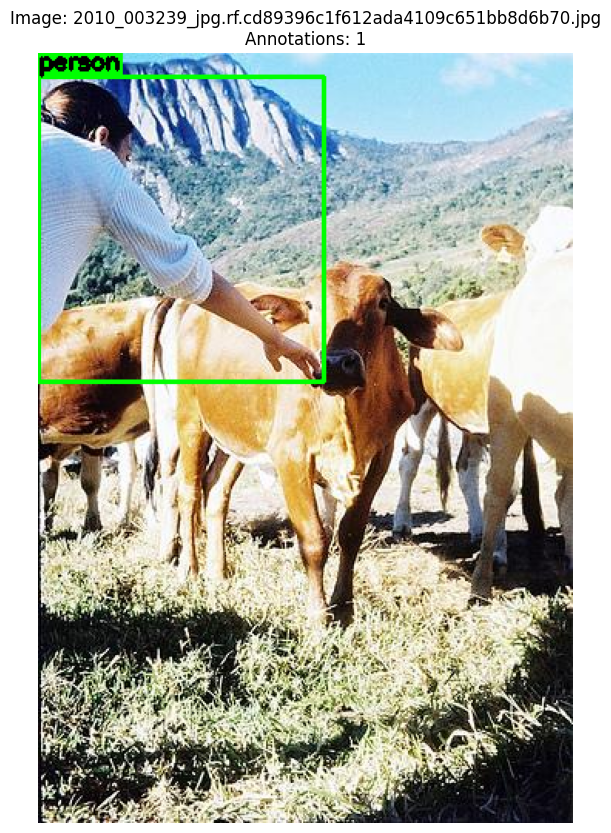

Image: 2010_003239_jpg.rf.cd89396c1f612ada4109c651bb8d6b70.jpg
Dimensions: 347x500
Number of people detected: 1

Bounding boxes:
  Person: [0, 15, 185, 213]
--------------------------------------------------

Random training samples:

Sample 1/3:


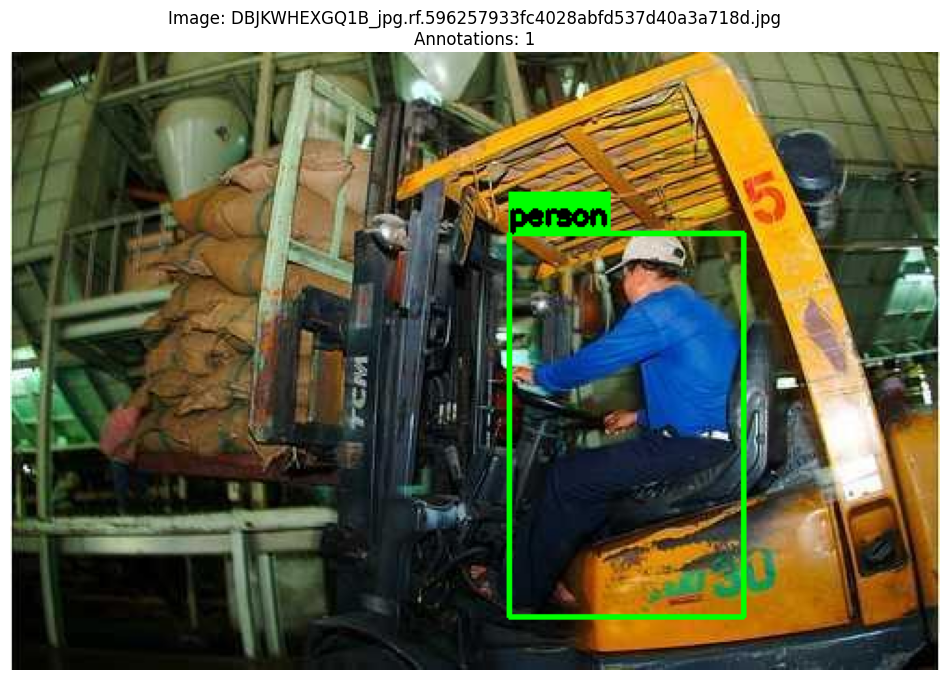

Image: DBJKWHEXGQ1B_jpg.rf.596257933fc4028abfd537d40a3a718d.jpg
Dimensions: 500x332
Number of people detected: 1

Bounding boxes:
  Person: [268, 97, 394, 303]
--------------------------------------------------

Sample 2/3:


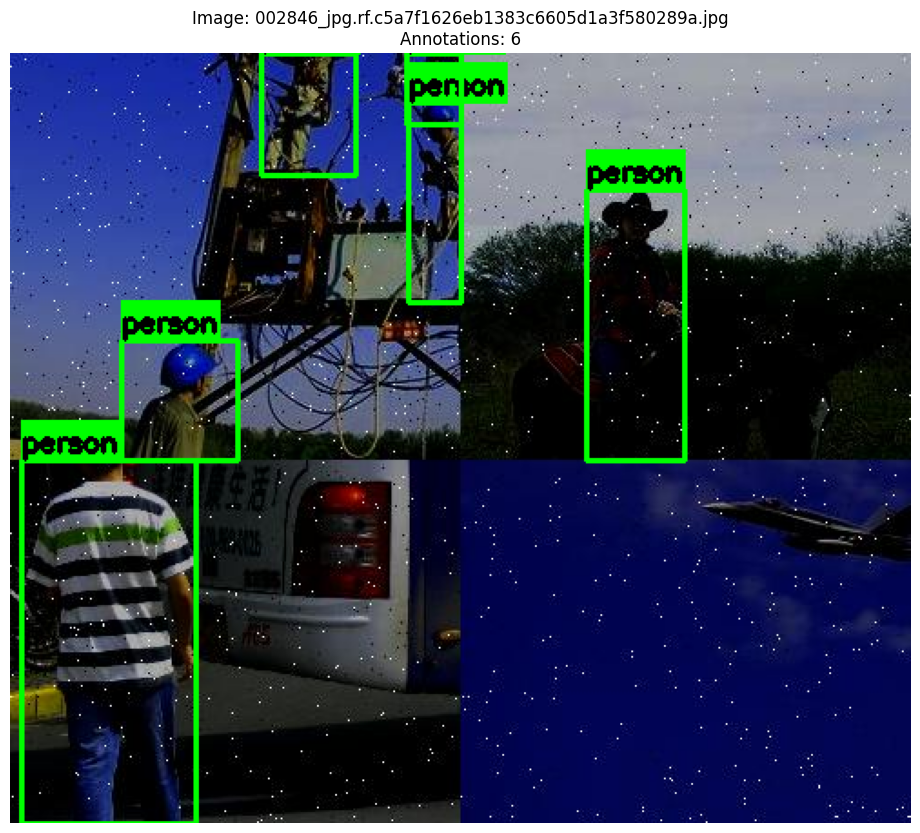

Image: 002846_jpg.rf.c5a7f1626eb1383c6605d1a3f580289a.jpg
Dimensions: 496x424
Number of people detected: 6

Bounding boxes:
  Person: [61, 158, 125, 224]
  Person: [219, 27, 248, 137]
  Person: [138, 0, 190, 67]
  Person: [218, 0, 248, 39]
  Person: [317, 75, 371, 224]
  Person: [6, 224, 102, 424]
--------------------------------------------------

Sample 3/3:


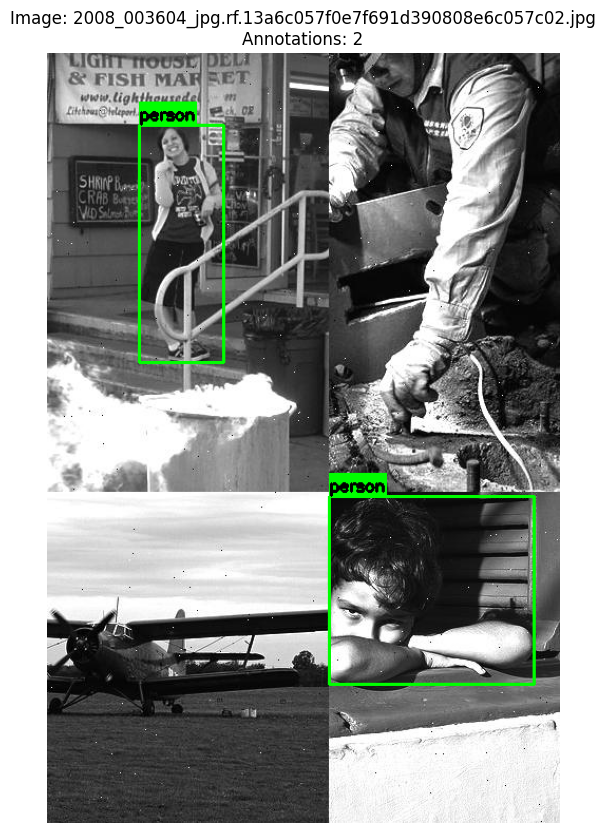

Image: 2008_003604_jpg.rf.13a6c057f0e7f691d390808e6c057c02.jpg
Dimensions: 486x730
Number of people detected: 2

Bounding boxes:
  Person: [87, 68, 167, 293]
  Person: [267, 420, 461, 598]
--------------------------------------------------


In [9]:
import glob

train_labels = pd.read_csv("/content/datasets/people_detection/train/train/_annotations.csv")
test_labels = pd.read_csv("/content/datasets/people_detection/test/test/_annotations.csv")
val_labels = pd.read_csv("/content/datasets/people_detection/valid/valid/_annotations.csv")

print(f"Training annotations: {len(train_labels)}")
print(f"Test annotations: {len(test_labels)}")
print(f"Validation annotations: {len(val_labels)}")

train_images = glob.glob('/content/datasets/people_detection/train/train/*.jpg')
test_images = glob.glob('/content/datasets/people_detection/test/test/*.jpg')
val_images = glob.glob('/content/datasets/people_detection/valid/valid/*.jpg')

print(f"\nTraining images: {len(train_images)}")
print(f"Test images: {len(test_images)}")
print(f"Validation images: {len(val_images)}")


# Display sample image with annotations from CSV
def show_sample(image_path, labels_df):
    """
    Display image with bounding boxes from CSV annotations

    Args:
        image_path: Path to the image file
        labels_df: DataFrame containing annotations for all images
    """
    img = cv2.imread(image_path)
    if img is None:
        print(f"Could not load image: {image_path}")
        return

    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Get filename from path
    filename = os.path.basename(image_path)

    # Filter annotations for this specific image
    img_annotations = labels_df[labels_df['filename'] == filename]

    if not img_annotations.empty:
        for _, row in img_annotations.iterrows():
            # Get bounding box coordinates from CSV
            x1 = int(row['xmin'])
            y1 = int(row['ymin'])
            x2 = int(row['xmax'])
            y2 = int(row['ymax'])
            class_name = row['class']

            # Draw bounding box
            cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)

            # Add label text
            label = f"{class_name}"
            # Get text size for background rectangle
            (text_width, text_height), baseline = cv2.getTextSize(
                label, cv2.FONT_HERSHEY_SIMPLEX, 0.5, 2
            )

            # Draw background rectangle for text
            cv2.rectangle(
                img,
                (x1, y1 - text_height - 10),
                (x1 + text_width, y1),
                (0, 255, 0),
                -1  # Filled rectangle
            )

            # Add text
            cv2.putText(
                img,
                label,
                (x1, y1 - 5),
                cv2.FONT_HERSHEY_SIMPLEX,
                0.5,
                (0, 0, 0),  # Black text
                2
            )

    # Display image
    plt.figure(figsize=(12, 10))
    plt.imshow(img)
    plt.axis('off')

    # Add title with annotation count
    num_annotations = len(img_annotations)
    plt.title(f"Image: {filename}\nAnnotations: {num_annotations}")
    plt.show()

    # Print annotation details
    print(f"Image: {filename}")
    print(f"Dimensions: {img.shape[1]}x{img.shape[0]}")
    print(f"Number of people detected: {num_annotations}")

    if not img_annotations.empty:
        print("\nBounding boxes:")
        for _, row in img_annotations.iterrows():
            print(f"  Person: [{row['xmin']}, {row['ymin']}, {row['xmax']}, {row['ymax']}]")

    print("-" * 50)

# Display multiple samples
def show_multiple_samples(image_paths, labels_df, num_samples=3):
    """Display multiple sample images"""
    import random

    if len(image_paths) < num_samples:
        num_samples = len(image_paths)

    sampled_paths = random.sample(image_paths, num_samples)

    for i, img_path in enumerate(sampled_paths, 1):
        print(f"\nSample {i}/{num_samples}:")
        show_sample(img_path, labels_df)

# Display a sample from training set
if train_images:
    img_path = train_images[0]
    print("First training image:")
    show_sample(img_path, train_labels)

# Display random samples
print("\nRandom training samples:")
show_multiple_samples(train_images, train_labels, num_samples=3)


## Step 3.4: Train YOLO8 Model

We train YOLOv8n to detect people. We must create a `data.yaml` file pointing to our folders.

In [10]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f"Using device: {device}")

if torch.cuda.is_available():
    gpu_name = torch.cuda.get_device_name(0)
    gpu_memory = torch.cuda.get_device_properties(0).total_memory / 1024**3
    print(f"GPU: {gpu_name}")
    print(f"GPU Memory: {gpu_memory:.2f} GB")

    # Enable L4 optimizations
    if 'L4' in gpu_name:
        torch.backends.cudnn.benchmark = True
        torch.backends.cuda.matmul.allow_tf32 = True
        torch.backends.cudnn.allow_tf32 = True
    else:
        torch.backends.cudnn.benchmark = True
        print(f"GPU: {gpu_name}")

    torch.cuda.empty_cache()
else:
    print("WARNING: CUDA not available")

# Automatic Checkpoint Resume
last_checkpoint = '/content/results/face_detection_l4/weights/last.pt'
resume_training = os.path.exists(last_checkpoint)

if resume_training:
    print(f"Resuming from: {last_checkpoint}")
    model = YOLO(last_checkpoint)
else:
    print("Starting fresh with YOLOv8n")
    model = YOLO('yolov8n.pt')

# L4-Optimized Training Configuration
train_args = {
    # Data & Duration
    'data': '/content/datasets/people_detection_yolo/data.yaml',
    'epochs': 100,

    # L4 Performance Settings
    'imgsz': 640,
    'batch': 48,          # 🚀 1.5x larger than T4 (L4 has 24GB VRAM)
    'workers': 6,         # 🚀 More workers for faster GPU
    'device': device,
    'amp': True,          # Mixed precision
    'cache': 'ram',       # Cache in RAM

    # Checkpointing
    'save': True,
    'save_period': 8,     # Save every 8 epochs
    'project': '/content/results',
    'name': 'face_detection_l4',
    'exist_ok': True,
    'resume': resume_training,

    # Optimization
    'optimizer': 'AdamW',
    'lr0': 0.0012,        # Slightly higher for larger batch
    'lrf': 0.01,
    'momentum': 0.937,
    'weight_decay': 0.0005,
    'warmup_epochs': 3.0,
    'warmup_momentum': 0.8,
    'warmup_bias_lr': 0.1,

    # Loss Weights
    'box': 7.5,
    'cls': 0.5,
    'dfl': 1.5,

    # Face-Optimized Augmentation
    'hsv_h': 0.015,
    'hsv_s': 0.7,
    'hsv_v': 0.4,
    'degrees': 10.0,
    'translate': 0.1,
    'scale': 0.5,
    'shear': 0.0,
    'perspective': 0.0,
    'flipud': 0.0,
    'fliplr': 0.5,
    'mosaic': 1.0,
    'mixup': 0.1,
    'copy_paste': 0.0,

    # Monitoring
    'val': True,
    'plots': True,
    'patience': 30,
    'verbose': True,

    # Advanced
    'pretrained': True,
    'freeze': None,
    'seed': 42,
    'deterministic': True,
    'single_cls': True,
    'cos_lr': True,
    'close_mosaic': 10,
}


print("\n" + "="*60)
print("TRAINING CONFIGURATION")
print("="*60)
print(f"Model:          YOLOv8n")
print(f"Dataset:        15,210 images")
print(f"Batch Size:     {train_args['batch']}")
print(f"Epochs:         {train_args['epochs']}")
print(f"Workers:        {train_args['workers']}")
print(f"\nExpected:")
print(f"  • Time:       100-150 minutes (~2 hours)")
print(f"  • Speed:      60-80 images/sec")
print(f"  • Cost:       ~$1.00")
print(f"  • Speedup:    1.5-2x faster than T4")
print("="*60 + "\n")


try:
    results = model.train(**train_args)
    print("\nTraining completed!")

    import pandas as pd
    df = pd.read_csv('/content/results/face_detection_l4/results.csv')
    df.columns = df.columns.str.strip()
    best_epoch = df['metrics/mAP50-95(B)'].idxmax()

    print("\nBest Results:")
    print(f"  Epoch: {best_epoch + 1}")
    print(f"  mAP@0.5: {df.loc[best_epoch, 'metrics/mAP50(B)']:.4f}")
    print(f"  mAP@0.5:0.95: {df.loc[best_epoch, 'metrics/mAP50-95(B)']:.4f}")
    print(f"\nModel: /content/results/face_detection_l4/weights/best.pt")

except KeyboardInterrupt:
    print("\nTraining interrupted - will resume next run")
except Exception as e:
    print(f"\nError: {e}")
    raise

✓ Using device: cuda
GPU: NVIDIA L4
GPU Memory: 22.16 GB
Resuming from: /content/results/face_detection_l4/weights/last.pt

TRAINING CONFIGURATION
Model:          YOLOv8n
Dataset:        15,210 images
Batch Size:     48
Epochs:         100
Workers:        6

Expected:
  • Time:       100-150 minutes (~2 hours)
  • Speed:      60-80 images/sec
  • Cost:       ~$1.00
  • Speedup:    1.5-2x faster than T4



/usr/local/lib/python3.12/dist-packages/torch/backends/__init__.py:46: UserWarning: Please use the new API settings to control TF32 behavior, such as torch.backends.cudnn.conv.fp32_precision = 'tf32' or torch.backends.cuda.matmul.fp32_precision = 'ieee'. Old settings, e.g, torch.backends.cuda.matmul.allow_tf32 = True, torch.backends.cudnn.allow_tf32 = True, allowTF32CuDNN() and allowTF32CuBLAS() will be deprecated after Pytorch 2.9. Please see https://pytorch.org/docs/main/notes/cuda.html#tensorfloat-32-tf32-on-ampere-and-later-devices (Triggered internally at /pytorch/aten/src/ATen/Context.cpp:80.)
  self.setter(val)


Ultralytics 8.3.235 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (NVIDIA L4, 22693MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=48, bgr=0.0, box=7.5, cache=ram, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=True, cutmix=0.0, data=/content/datasets/people_detection_yolo/data.yaml, degrees=10.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.0012, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.1, mode=train, model=/content/results/face_detection_l4/weights/last.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=face_detection_l4, nbs=64, nms=False, opset=None, optimize=False, optimizer=Ada

In [49]:
# We copy the output to Google Drive
!cp -r /content/results/face_detection_l4 /content/drive/MyDrive/


### Review training result

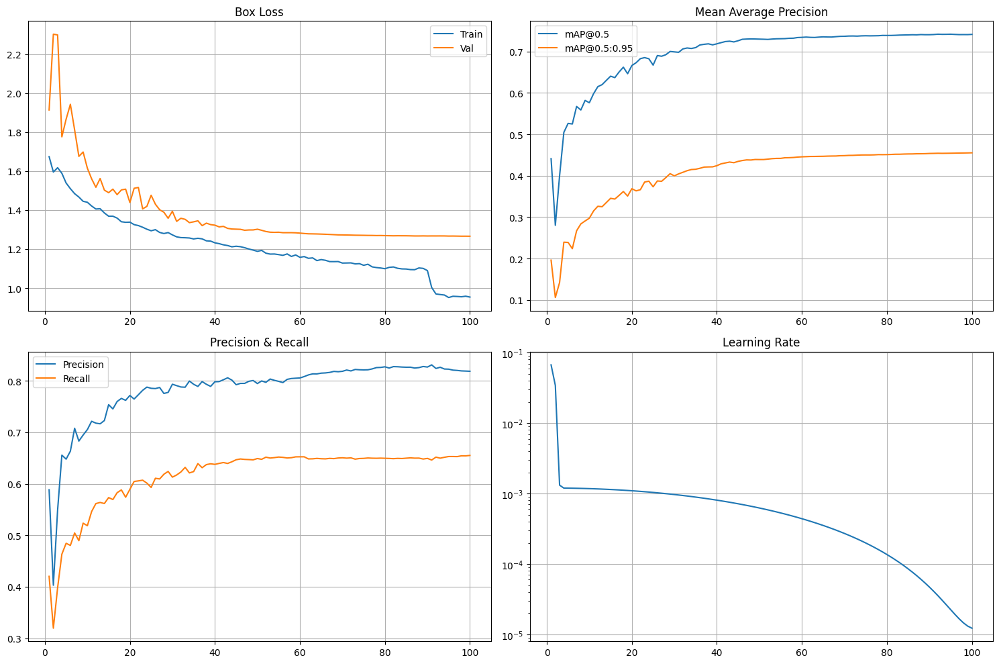

\nBest epoch: 100
mAP@0.5: 0.7415
mAP@0.5:0.95: 0.4554


In [12]:
df = pd.read_csv('/content/results/face_detection_l4/results.csv')
df.columns = df.columns.str.strip()

fig, axes = plt.subplots(2, 2, figsize=(15, 10))

# Loss curves
axes[0, 0].plot(df['epoch'], df['train/box_loss'], label='Train')
axes[0, 0].plot(df['epoch'], df['val/box_loss'], label='Val')
axes[0, 0].set_title('Box Loss')
axes[0, 0].legend()
axes[0, 0].grid(True)

# mAP curves
axes[0, 1].plot(df['epoch'], df['metrics/mAP50(B)'], label='mAP@0.5')
axes[0, 1].plot(df['epoch'], df['metrics/mAP50-95(B)'], label='mAP@0.5:0.95')
axes[0, 1].set_title('Mean Average Precision')
axes[0, 1].legend()
axes[0, 1].grid(True)

# Precision & Recall
axes[1, 0].plot(df['epoch'], df['metrics/precision(B)'], label='Precision')
axes[1, 0].plot(df['epoch'], df['metrics/recall(B)'], label='Recall')
axes[1, 0].set_title('Precision & Recall')
axes[1, 0].legend()
axes[1, 0].grid(True)

# Learning Rate
axes[1, 1].plot(df['epoch'], df['lr/pg0'])
axes[1, 1].set_title('Learning Rate')
axes[1, 1].set_yscale('log')
axes[1, 1].grid(True)

plt.tight_layout()
plt.show()

# Summary
best_epoch = df['metrics/mAP50-95(B)'].idxmax()
print(f"\\nBest epoch: {best_epoch + 1}")
print(f"mAP@0.5: {df.loc[best_epoch, 'metrics/mAP50(B)']:.4f}")
print(f"mAP@0.5:0.95: {df.loc[best_epoch, 'metrics/mAP50-95(B)']:.4f}")

## Step 3.5: Test Inference with the Best Model


=== Training Results Summary ===
    epoch     time  train/box_loss  train/cls_loss  train/dfl_loss  \
95     96  7461.45         0.95769         0.67361         1.04190   
96     97  7550.06         0.95669         0.67274         1.04302   
97     98  7638.65         0.95512         0.67021         1.04192   
98     99  7727.85         0.95807         0.67385         1.04275   
99    100  7816.70         0.95352         0.66783         1.03999   

    metrics/precision(B)  metrics/recall(B)  metrics/mAP50(B)  \
95               0.82098            0.65307           0.74143   
96               0.82039            0.65291           0.74099   
97               0.81946            0.65442           0.74105   
98               0.81913            0.65432           0.74100   
99               0.81876            0.65518           0.74149   

    metrics/mAP50-95(B)  val/box_loss  val/cls_loss  val/dfl_loss    lr/pg0  \
95              0.45461       1.26666       0.79082       1.16107  0.000019

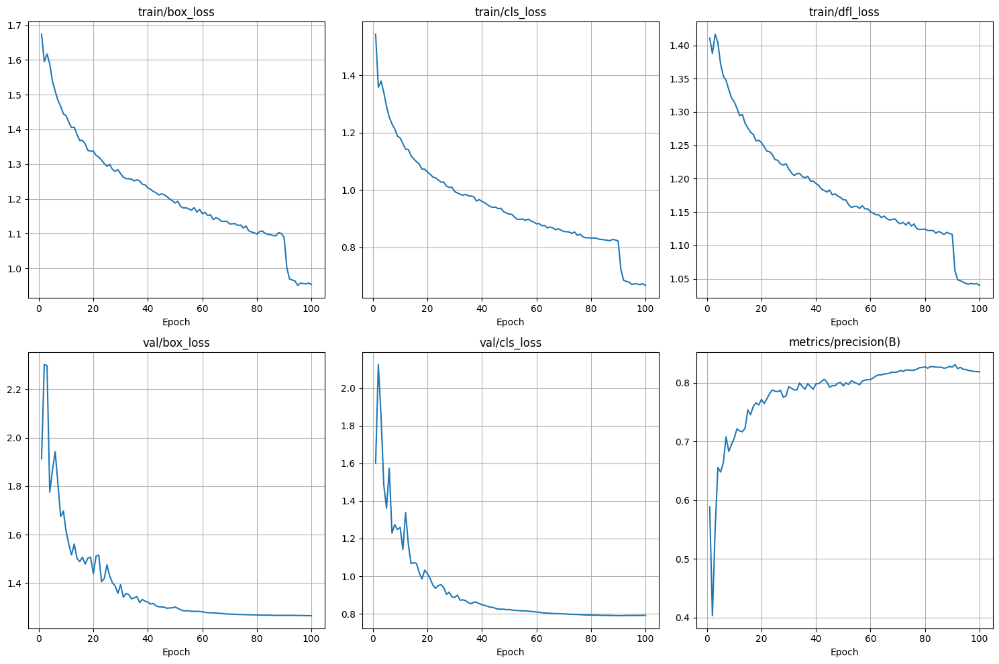


=== Validation Metrics ===
Ultralytics 8.3.235 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (NVIDIA L4, 22693MiB)
Model summary (fused): 72 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1343.2±843.9 MB/s, size: 91.1 KB)
val: Scanning /content/datasets/people_detection_yolo/val/labels.cache... 1370 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 1370/1370 2.5Mit/s 0.0s
val: /content/datasets/people_detection_yolo/val/images/GX010023_frame_00025_right_jpg.rf.3255febc597d78d5d6e4bde455ba7b2a.jpg: 23 duplicate labels removed
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 86/86 5.8it/s 14.9s
                   all       1370      10660      0.825      0.667      0.752      0.458
Speed: 0.6ms preprocess, 5.9ms inference, 0.0ms loss, 0.9ms postprocess per image
Saving /content/runs/detect/val3/predictions.json...
Results saved to /content/runs/detect/val3
mAP50-95: 0.4581
m

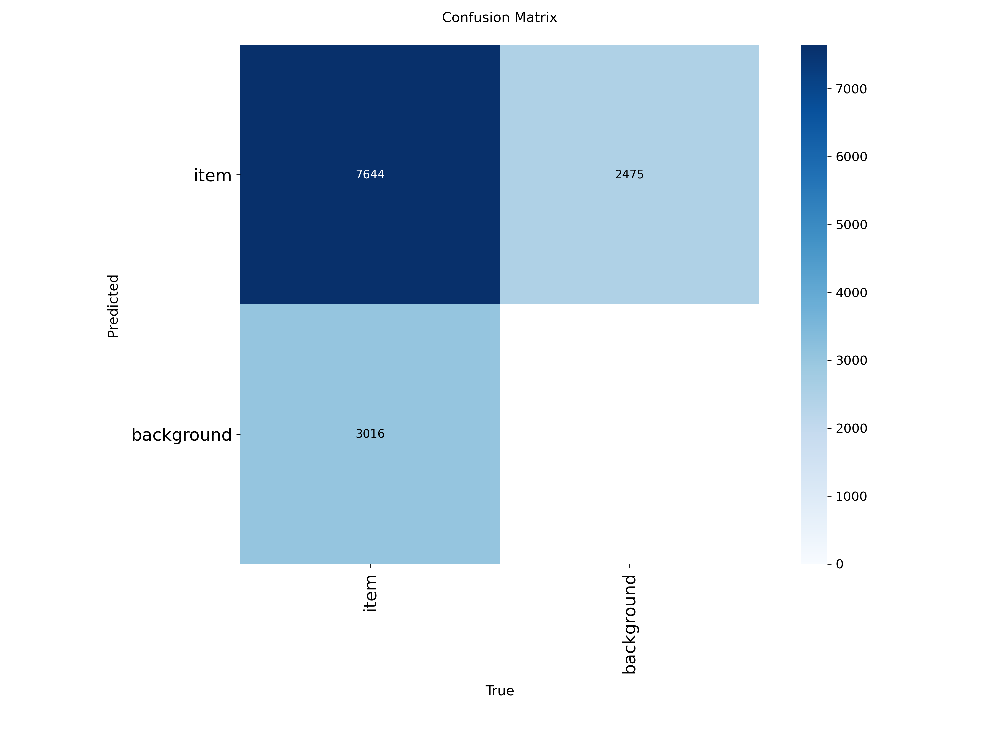


Displaying: results.png


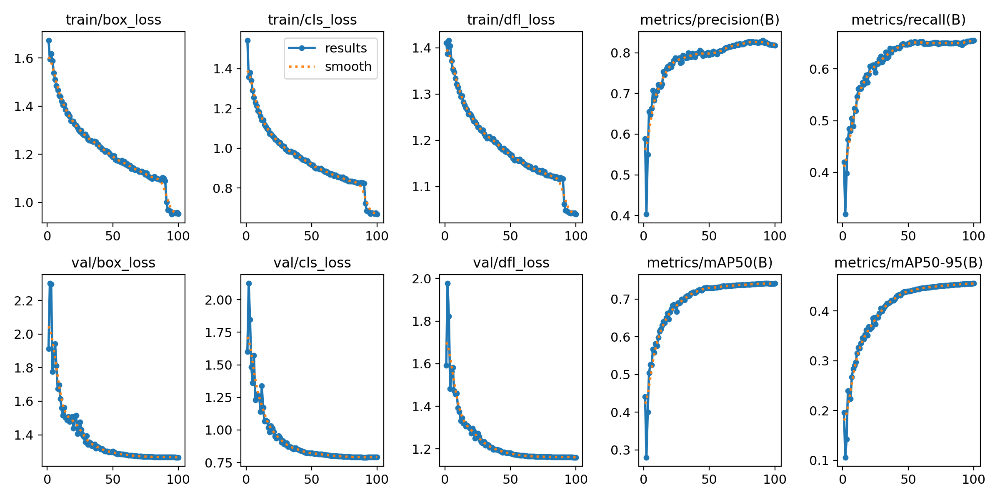


=== Testing on Sample Images ===

WARNING ⚠️ 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

image 1/1370 /content/datasets/people_detection_yolo/val/images/-1_-Av513706663-P1-_mp4-0_jpg.rf.75899bfbd97ba6ce3ec70fde16b16fa5.jpg: 384x640 13 items, 166.7ms
image 2/1370 /content/datasets/people_detection_yolo/val/images/-1_-Av513706663-P1-_mp4-13_jpg.rf.8267749fcacb971bbd911165ca193332.jpg: 384x640 6 items, 6.5ms
image 3/1370 /content/datasets/people_detection_yolo/val/images/-1_-Av513706663-P1-_mp4-15_jpg.rf.57eb

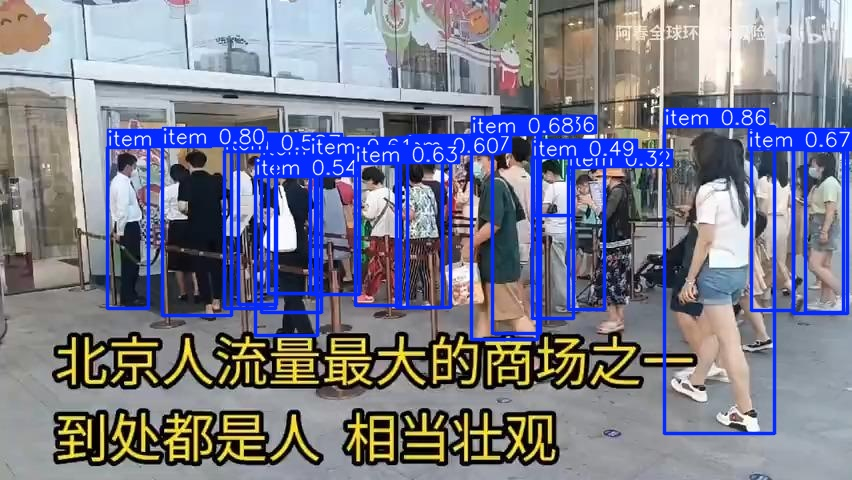


Prediction: -1_-Av513706663-P1-_mp4-13_jpg.rf.8267749fcacb971bbd911165ca193332.jpg


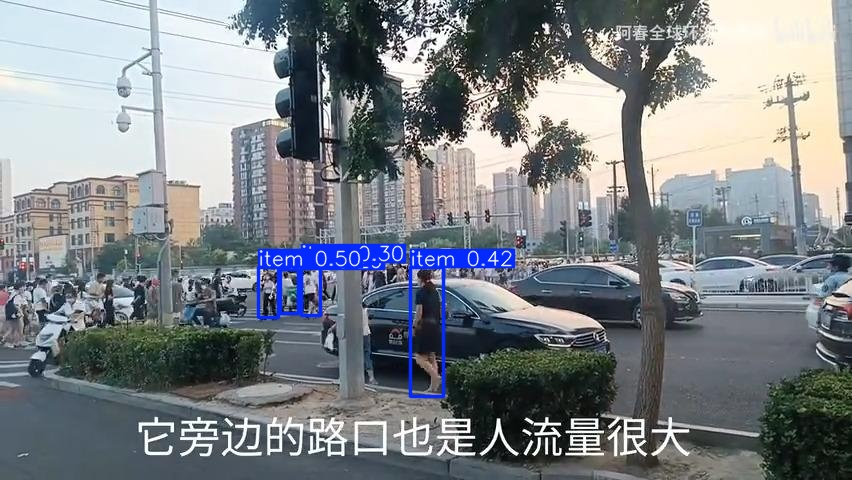


Prediction: -1_-Av513706663-P1-_mp4-15_jpg.rf.57ebf3ac6960bc954edf8e73e59426e0.jpg


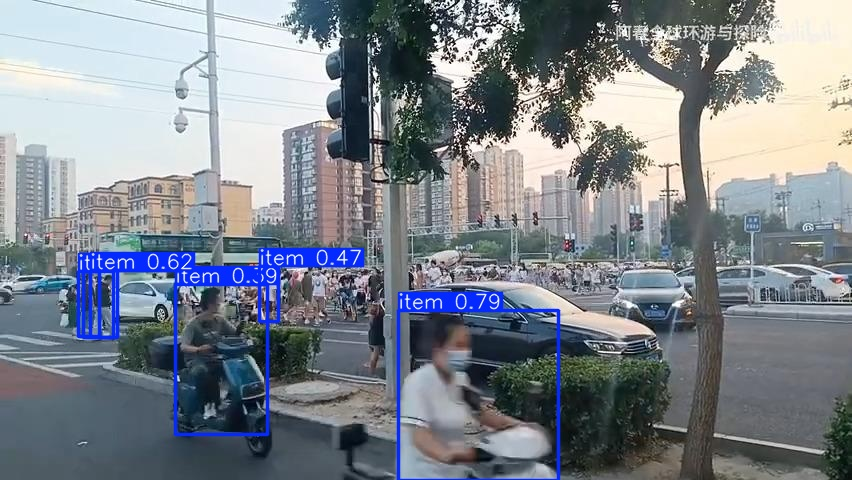


Prediction: -1_-Av513706663-P1-_mp4-16_jpg.rf.85ded751aaef2217abf21519d84dc67c.jpg


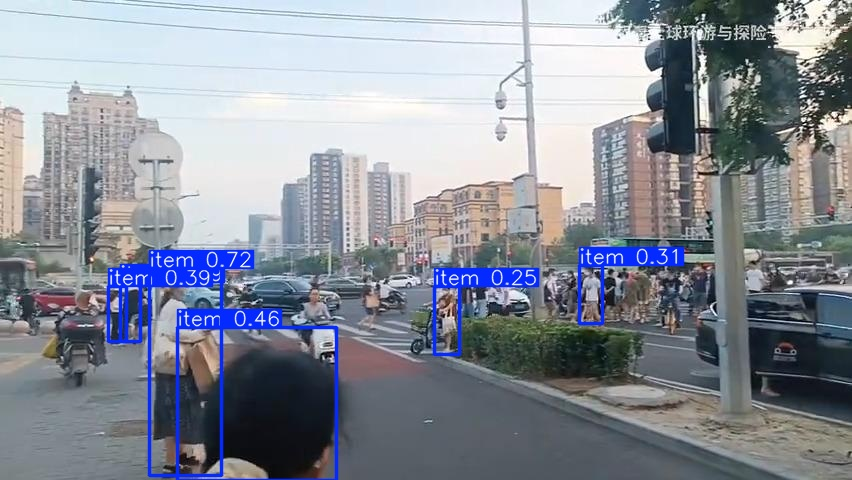


Prediction: -1_-Av513706663-P1-_mp4-18_jpg.rf.51efd03ddf8a74efad756315c8bd2992.jpg


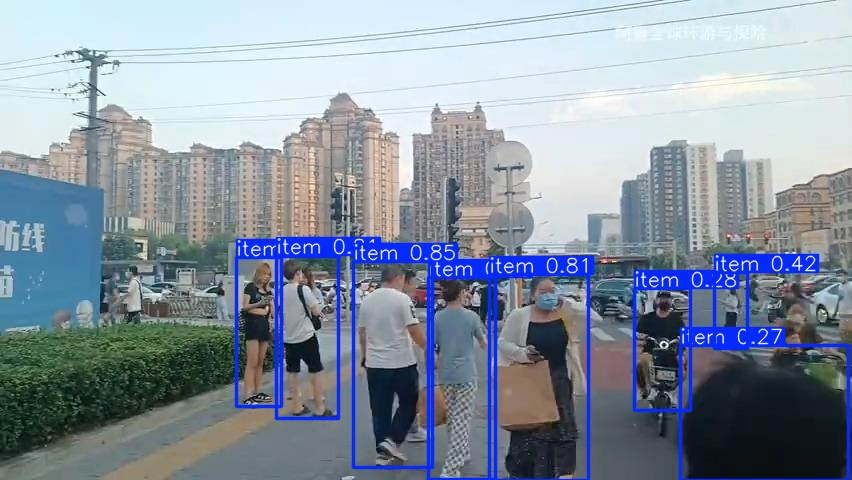

In [13]:
# Load the best model
best_model = YOLO('/content/results/face_detection_l4/weights/best.pt')

results_path = '/content/results/face_detection_l4/results.csv'
if os.path.exists(results_path):
    import pandas as pd
    results_df = pd.read_csv(results_path)
    print("\n=== Training Results Summary ===")
    print(results_df.tail())  # Show last few epochs

    fig, axes = plt.subplots(2, 3, figsize=(15, 10))

    metrics_to_plot = ['train/box_loss', 'train/cls_loss', 'train/dfl_loss',
                      'val/box_loss', 'val/cls_loss', 'metrics/precision(B)']

    for ax, metric in zip(axes.flat, metrics_to_plot):
        if metric in results_df.columns:
            ax.plot(results_df['epoch'], results_df[metric])
            ax.set_title(metric)
            ax.set_xlabel('Epoch')
            ax.grid(True)

    plt.tight_layout()
    plt.show()

print("\n=== Validation Metrics ===")
metrics = best_model.val(
    data='/content/datasets/people_detection_yolo/data.yaml',
    split='val',
    batch=16,
    imgsz=640,
    device=device,
    plots=True,
    save_json=True,
    conf=0.001,
    iou=0.6
)

print(f"mAP50-95: {metrics.box.map:.4f}")
print(f"mAP50: {metrics.box.map50:.4f}")
print(f"mAP75: {metrics.box.map75:.4f}")
print(f"Precision: {metrics.box.p.item():.4f}")
print(f"Recall: {metrics.box.r.item():.4f}")

print("\n=== Generated Plots ===")
plots_dir = '/content/results/face_detection_l4'
plot_files = ['confusion_matrix.png', 'F1_curve.png', 'P_curve.png',
              'R_curve.png', 'PR_curve.png', 'results.png']

from IPython.display import Image as DisplayImage

for plot_file in plot_files:
    plot_path = os.path.join(plots_dir, plot_file)
    if os.path.exists(plot_path):
        print(f"\nDisplaying: {plot_file}")
        display(DisplayImage(filename=plot_path, width=600))

print("\n=== Testing on Sample Images ===")
test_results = best_model.predict(
    source='/content/datasets/people_detection_yolo/val/images',  # Changed 'valid' to 'val'
    save=True,
    save_txt=True,
    save_conf=True,
    conf=0.25,
    iou=0.7,
    device=device,
    project='/content/results',
    name='predictions'
)

print(f"Generated {len(test_results)} predictions")
if len(test_results) > 0:
    # Display first few predictions
    prediction_dir = '/content/results/predictions'
    if os.path.exists(prediction_dir):
        pred_images = sorted(os.listdir(prediction_dir))[:5]
        for img_file in pred_images:
            if img_file.endswith(('.jpg', '.png', '.jpeg')):
                img_path = os.path.join(prediction_dir, img_file)
                print(f"\nPrediction: {img_file}")
                display(DisplayImage(filename=img_path, width=400))


image 1/1 /content/datasets/people_detection/train/train/2010_003239_jpg.rf.cd89396c1f612ada4109c651bb8d6b70.jpg: 640x448 1 item, 7.7ms
Speed: 2.3ms preprocess, 7.7ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 448)
Results saved to /content/results/predictions2
1343 labels saved to /content/results/predictions2/labels


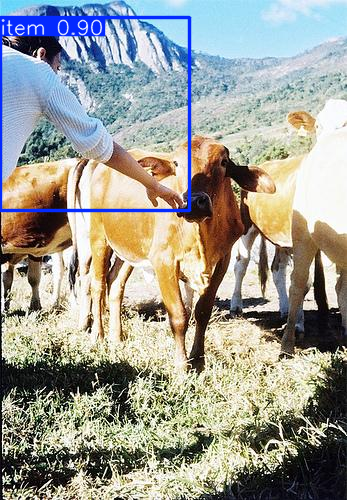


Detected 1 people
  Confidence: 0.90, BBox: [0.0, 17.732698440551758, 189.25392150878906, 210.21583557128906]


In [14]:
sample_image = train_images[0] if train_images else None
if sample_image:
    results = best_model(sample_image)

    for result in results:
        result.show()
        result.save(filename='/content/sample_prediction.jpg')  # Save prediction

    boxes = result.boxes
    print(f"\nDetected {len(boxes)} people")
    for box in boxes:
        print(f"  Confidence: {box.conf.item():.2f}, BBox: {box.xyxy[0].tolist()}")


## Step 3.6: Export model for Deployment



In [15]:
export_formats = ['onnx', 'torchscript', 'tflite', 'pb', 'saved_model']

for fmt in export_formats:
    try:
        best_model.export(format=fmt, imgsz=640, optimize=True, device='cpu') # Changed device from 0 to 'cpu'
        print(f"Exported to {fmt} format")
    except Exception as e:
        print(f"Failed to export to {fmt}: {str(e)}")

Ultralytics 8.3.235 🚀 Python-3.12.12 torch-2.9.0+cu126 CPU (Intel Xeon CPU @ 2.20GHz)
💡 ProTip: Export to OpenVINO format for best performance on Intel hardware. Learn more at https://docs.ultralytics.com/integrations/openvino/

PyTorch: starting from '/content/results/face_detection_l4/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 5, 8400) (5.9 MB)
requirements: Ultralytics requirements ['onnx>=1.12.0,<=1.19.1', 'onnxslim>=0.1.71', 'onnxruntime-gpu'] not found, attempting AutoUpdate...
Using Python 3.12.12 environment at: /usr
Resolved 14 packages in 193ms
Prepared 6 packages in 3.66s
Installed 6 packages in 254ms
 + colorama==0.4.6
 + coloredlogs==15.0.1
 + humanfriendly==10.0
 + onnx==1.19.1
 + onnxruntime-gpu==1.23.2
 + onnxslim==0.1.78

requirements: AutoUpdate success ✅ 4.8s
WARNING ⚠️ requirements: Restart runtime or rerun command for updates to take effect


ONNX: starting export with onnx 1.19.1 opset 22...
ONNX: slimming with onnxslim 0.1.78.

## Step 3.7: Save to Google Drive

To make it easy to revert to progress after the runtime shuts down, we can save the model to Google.  

In [16]:
!mkdir -p "/content/drive/MyDrive/YOLO_People_Detection"
!cp -r "/content/results/face_detection_l4" "/content/drive/MyDrive/YOLO_People_Detection/"
!cp "/content/results/face_detection_l4/weights/best.pt" "/content/drive/MyDrive/YOLO_People_Detection/best_model.pt"

print("Training completed! Model saved to Google Drive.")

Training completed! Model saved to Google Drive.


## Step 3.8: Create a Simple Inference Function

We will use tthis later when checking the images.


image 1/1 /content/datasets/people_detection/train/train/2010_003239_jpg.rf.cd89396c1f612ada4109c651bb8d6b70.jpg: 640x448 1 item, 79.0ms
Speed: 1.8ms preprocess, 79.0ms inference, 15.0ms postprocess per image at shape (1, 3, 640, 448)


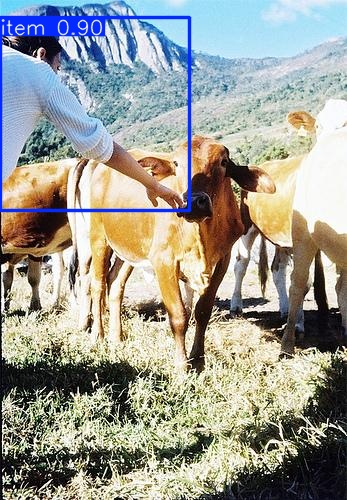

Detected 1 people


In [17]:
class PeopleDetector:
    def __init__(self, model_path):
        self.model = YOLO(model_path)

    def detect(self, image_path, conf_threshold=0.25, iou_threshold=0.45):
        """
        Detect people in an image
        """
        results = self.model.predict(
            source=image_path,
            conf=conf_threshold,
            iou=iou_threshold,
            imgsz=640,
            device='cpu'
        )

        detections = []
        for result in results:
            boxes = result.boxes
            if boxes is not None:
                for box in boxes:
                    detections.append({
                        'bbox': box.xyxy[0].tolist(),
                        'confidence': box.conf.item(),
                        'class': 'person'
                    })

        return detections, results[0].plot()  # Return detections and annotated image

# Test the detector
detector = PeopleDetector('/content/results/face_detection_l4/weights/best.pt')
detections, annotated_img = detector.detect(sample_image)

# Save annotated image
cv2.imwrite('/content/final_detection.jpg', annotated_img)
display(DisplayImage(filename='/content/final_detection.jpg', width=400))
print(f"Detected {len(detections)} people")

# Phase 4 Dataset 1: Emotion Detection

## Step 4.1.1: Downloading and Unzipping the Dataset

Facial Emotion Recognition Dataset (FER) – https://www.kaggle.com/datasets/tapakah68/facial-emotion-recognition

In [18]:
# Downloading and unzipping the dataset
!mkdir -p /content/datasets
!mkdir -p /content/datasets/facial_emotion_recognition

!curl -L -o /content/datasets/facial_emotion_recognition.zip https://www.kaggle.com/api/v1/datasets/download/tapakah68/facial-emotion-recognition

!unzip -q /content/datasets/facial_emotion_recognition -d /content/datasets/facial_emotion_recognition/

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
100  433M  100  433M    0     0   119M      0  0:00:03  0:00:03 --:--:--  146M


## Step 4.1.2: EDA: Explore the Dataset

In [19]:
IMG_SIZE = 128
DATA_DIR = '/content/datasets/facial_emotion_recognition/images'
EMOTIONS = ['Anger', 'Contempt', 'Disgust', 'Fear', 'Happy', 'Neutral', 'Sad', 'Surprised']

csv_path = '/content/datasets/facial_emotion_recognition/emotions.csv'
df = pd.read_csv(csv_path)

print(f"\nLoaded dataset with {len(df)} samples")
print(f"\nDataset Structure:")
print(f"  - Total Images: {len(df):,}")
print(f"  - Countries: {df['country'].nunique()}")
print(f"  - Sets: {df['set_id'].nunique()}")
print(f"  - Gender Categories: {df['gender'].nunique()}")
print(f"  - Age Groups: {df['age'].nunique()}\n\n")

df.head(10)


Loaded dataset with 19 samples

Dataset Structure:
  - Total Images: 19
  - Countries: 3
  - Sets: 19
  - Gender Categories: 2
  - Age Groups: 14




,set_id,gender,age,country
0,0,FEMALE,36,RU
1,1,FEMALE,37,RU
2,2,FEMALE,36,RU
3,3,MALE,29,RU
4,4,FEMALE,43,RU
5,5,MALE,49,RU
6,6,FEMALE,38,RU
7,7,MALE,19,PH
8,8,FEMALE,29,RU
9,9,FEMALE,32,RU


Facial geometry matters most - Emotions are primarily conveyed through:

- Muscle movements (smile, frown, eyebrow position)
- Wrinkle patterns (crow's feet, forehead lines)
- Eye shape and mouth curvature
These are all captured in grayscale


Color bias issues:

- Blushing only visible on lighter skin tones
- Creates unfair advantage for certain demographics
- Model becomes biased toward skin color rather than expression

Research shows that grayscale performs as well or better than RGB for emotion detection:

- Emotion is primarily conveyed through Action Units (facial muscle movements)
- Color adds noise more than signal
- Grayscale models generalize better across diverse populations

In [20]:
base_path = '/content/datasets/facial_emotion_recognition/images'

original_data = []

for idx, row in df.iterrows():
    set_id = row['set_id']
    folder_path = os.path.join(base_path, str(set_id))

    if os.path.exists(folder_path):
        jpg_files = [f for f in os.listdir(folder_path) if f.endswith('.jpg')]

        for jpg_file in jpg_files:
            emotion = jpg_file.replace('.jpg', '')
            img_path = os.path.join(folder_path, jpg_file)

            img = load_img(img_path, target_size=(IMG_SIZE, IMG_SIZE), color_mode='grayscale')
            img_array = img_to_array(img) / 255.0

            data_entry = {
                'set_id': set_id,
                'gender': row['gender'],
                'age': row['age'],
                'country': row['country'],
                'emotion': emotion,
                'image_path': img_path,
                'image': img_array,
                'augmented': False
            }

            original_data.append(data_entry)

df = pd.DataFrame(original_data)

actual_emotions = sorted(df['emotion'].unique())
EMOTIONS = actual_emotions
print(f"\nActual emotions found: {EMOTIONS}")
print(f"Number of emotion classes: {len(EMOTIONS)}")

print(f"Dataset created with {len(df)} images")
print(f"\nDataset shape: {df.shape}")
print(f"\nColumns: {df.columns.tolist()}")
print(f"\nFirst few rows:")
print(df[['set_id', 'gender', 'age', 'country', 'emotion']].head(10))
print(f"\nEmotion distribution:")
print(df['emotion'].value_counts())

df.head()


Actual emotions found: ['Anger', 'Contempt', 'Disgust', 'Fear', 'Happy', 'Neutral', 'Sad', 'Surprised']
Number of emotion classes: 8
Dataset created with 152 images

Dataset shape: (152, 8)

Columns: ['set_id', 'gender', 'age', 'country', 'emotion', 'image_path', 'image', 'augmented']

First few rows:
   set_id  gender  age country    emotion
0       0  FEMALE   36      RU      Anger
1       0  FEMALE   36      RU    Neutral
2       0  FEMALE   36      RU       Fear
3       0  FEMALE   36      RU      Happy
4       0  FEMALE   36      RU   Contempt
5       0  FEMALE   36      RU  Surprised
6       0  FEMALE   36      RU        Sad
7       0  FEMALE   36      RU    Disgust
8       1  FEMALE   37      RU      Anger
9       1  FEMALE   37      RU    Neutral

Emotion distribution:
emotion
Anger        19
Neutral      19
Fear         19
Happy        19
Contempt     19
Surprised    19
Sad          19
Disgust      19
Name: count, dtype: int64


,set_id,gender,age,country,emotion,image_path,image,augmented
0,0,FEMALE,36,RU,Anger,/content/datasets/facial_emotion_recognition/i...,"[[[0.8901961], [0.8392157], [0.87058824], [0.7...",False
1,0,FEMALE,36,RU,Neutral,/content/datasets/facial_emotion_recognition/i...,"[[[0.37254903], [0.5568628], [0.8666667], [0.4...",False
2,0,FEMALE,36,RU,Fear,/content/datasets/facial_emotion_recognition/i...,"[[[0.78039217], [0.7764706], [0.7764706], [0.7...",False
3,0,FEMALE,36,RU,Happy,/content/datasets/facial_emotion_recognition/i...,"[[[0.56078434], [0.8], [0.80784315], [0.8], [0...",False
4,0,FEMALE,36,RU,Contempt,/content/datasets/facial_emotion_recognition/i...,"[[[0.7411765], [0.7764706], [0.83137256], [0.1...",False


## Step 4.1.3: EDA: Comprehensive Analysis

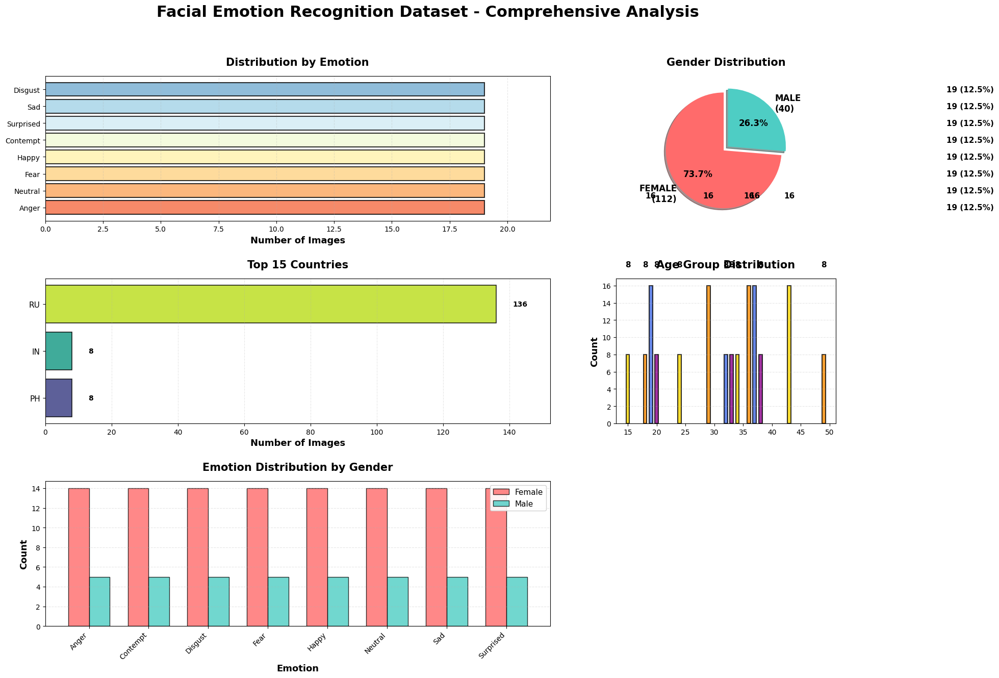

In [21]:
fig = plt.figure(figsize=(20, 14))
gs = fig.add_gridspec(3, 3, hspace=0.4, wspace=0.3)

fig.suptitle('Facial Emotion Recognition Dataset - Comprehensive Analysis',
             fontsize=22, fontweight='bold', y=0.98)


ax1 = fig.add_subplot(gs[0, :2])
emotion_counts = df['emotion'].value_counts().sort_values(ascending=True)
colors_emotion = plt.cm.RdYlBu(np.linspace(0.2, 0.8, len(emotion_counts)))
bars1 = ax1.barh(emotion_counts.index, emotion_counts.values, color=colors_emotion,
                 edgecolor='black', linewidth=1.5, alpha=0.8)
ax1.set_xlabel('Number of Images', fontsize=13, fontweight='bold')
ax1.set_title('Distribution by Emotion', fontsize=15, fontweight='bold', pad=15)
ax1.grid(axis='x', alpha=0.3, linestyle='--')
for i, (idx, val) in enumerate(emotion_counts.items()):
    ax1.text(val + 20, i, f'{val:,} ({val/len(df)*100:.1f}%)',
             va='center', fontsize=11, fontweight='bold')
ax1.set_xlim(0, max(emotion_counts.values) * 1.15)



ax2 = fig.add_subplot(gs[0, 2])
gender_counts = df['gender'].value_counts()
colors_gender = ['#FF6B6B', '#4ECDC4']
wedges, texts, autotexts = ax2.pie(gender_counts.values, labels=gender_counts.index,
                                    autopct='%1.1f%%', startangle=90, colors=colors_gender,
                                    textprops={'fontsize': 12, 'fontweight': 'bold'},
                                    explode=(0.05, 0.05), shadow=True)
ax2.set_title('Gender Distribution', fontsize=15, fontweight='bold', pad=15)
for i, (label, count) in enumerate(zip(gender_counts.index, gender_counts.values)):
    texts[i].set_text(f'{label}\n({count:,})')



ax3 = fig.add_subplot(gs[1, :2])
country_counts = df['country'].value_counts().head(15).sort_values(ascending=True)
colors_country = plt.cm.viridis(np.linspace(0.2, 0.9, len(country_counts)))
bars3 = ax3.barh(range(len(country_counts)), country_counts.values, color=colors_country,
                 edgecolor='black', linewidth=1.2, alpha=0.85)
ax3.set_yticks(range(len(country_counts)))
ax3.set_yticklabels(country_counts.index, fontsize=11)
ax3.set_xlabel('Number of Images', fontsize=13, fontweight='bold')
ax3.set_title('Top 15 Countries', fontsize=15, fontweight='bold', pad=15)
ax3.grid(axis='x', alpha=0.3, linestyle='--')
for i, val in enumerate(country_counts.values):
    ax3.text(val + 5, i, f'{val:,}', va='center', fontsize=10, fontweight='bold')
ax3.set_xlim(0, max(country_counts.values) * 1.12)



ax4 = fig.add_subplot(gs[1, 2])
age_counts = df['age'].value_counts().sort_index()
colors_age = ['#FFD700', '#FF8C00', '#4169E1', '#8B008B']
bars4 = ax4.bar(age_counts.index, age_counts.values, color=colors_age,
                edgecolor='black', linewidth=1.5, alpha=0.8, width=0.6)
ax4.set_ylabel('Count', fontsize=13, fontweight='bold')
ax4.set_title('Age Group Distribution', fontsize=15, fontweight='bold', pad=15)
ax4.grid(axis='y', alpha=0.3, linestyle='--')
for bar in bars4:
    height = bar.get_height()
    ax4.text(bar.get_x() + bar.get_width()/2., height + 10,
             f'{int(height):,}', ha='center', va='bottom', fontsize=11, fontweight='bold')



ax5 = fig.add_subplot(gs[2, :2])
emotion_gender = pd.crosstab(df['emotion'], df['gender'])
x_pos = np.arange(len(emotion_gender.index))
width = 0.35
bars5_1 = ax5.bar(x_pos - width/2, emotion_gender['FEMALE'], width,
                  label='Female', color='#FF6B6B', edgecolor='black', linewidth=1, alpha=0.8)
bars5_2 = ax5.bar(x_pos + width/2, emotion_gender['MALE'], width,
                  label='Male', color='#4ECDC4', edgecolor='black', linewidth=1, alpha=0.8)
ax5.set_xlabel('Emotion', fontsize=13, fontweight='bold')
ax5.set_ylabel('Count', fontsize=13, fontweight='bold')
ax5.set_title('Emotion Distribution by Gender', fontsize=15, fontweight='bold', pad=15)
ax5.set_xticks(x_pos)
ax5.set_xticklabels(emotion_gender.index, rotation=45, ha='right', fontsize=10)
ax5.legend(fontsize=11, loc='upper right', framealpha=0.9)
ax5.grid(axis='y', alpha=0.3, linestyle='--')


plt.savefig('/content/datasets/facial_emotion_recognition/emotion_dataset_analysis.png',
            dpi=300, bbox_inches='tight', facecolor='white')


## Step 4.1.4: EDA: Preview the Images In The Dataset

The dataset has very few images. This is a concern for the data analysis, we may have to try to augment the dataset.

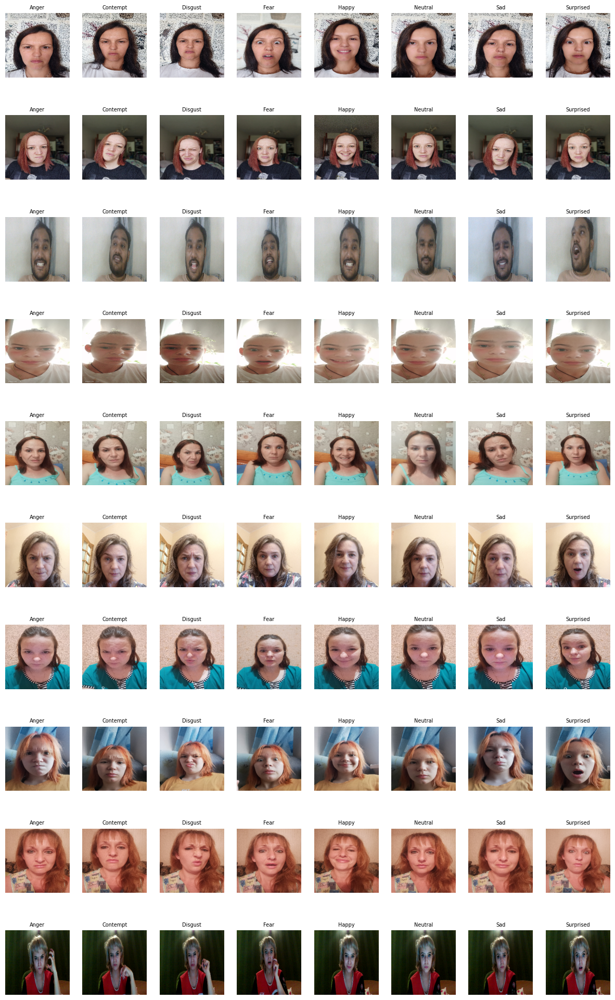

In [22]:
DIR = '/content/datasets/facial_emotion_recognition'
path_imgs = os.path.join(DIR, 'images')

all_folders = sorted([f for f in os.listdir(path_imgs) if os.path.isdir(os.path.join(path_imgs, f))])
folders_to_process = all_folders[:10]
plt.figure(figsize=(15, 25))
IM_SIZE = (200, 200)
ind = 0

for folder_name in folders_to_process:
    set_id = int(folder_name)

    for class_name in EMOTIONS:
        ind += 1
        path_img = os.path.join(path_imgs, str(set_id), class_name.capitalize() + '.jpg')

        if not os.path.isfile(path_img):
            print(f"Warning: File {path_img} does not exist.")
            continue

        img = cv2.imread(path_img)

        if img is None:
            print(f"Warning: Could not load image at {path_img}. Skipping.")
            continue

        img = cv2.resize(img, IM_SIZE)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        plt.subplot(len(folders_to_process), len(EMOTIONS), ind)
        plt.title(class_name, fontsize=7)
        plt.imshow(img)
        plt.axis('off')

plt.show()

## Step 4.1.5: Data Augmentation

Our dataset is small and limited. We will generate more images to help improve the training.

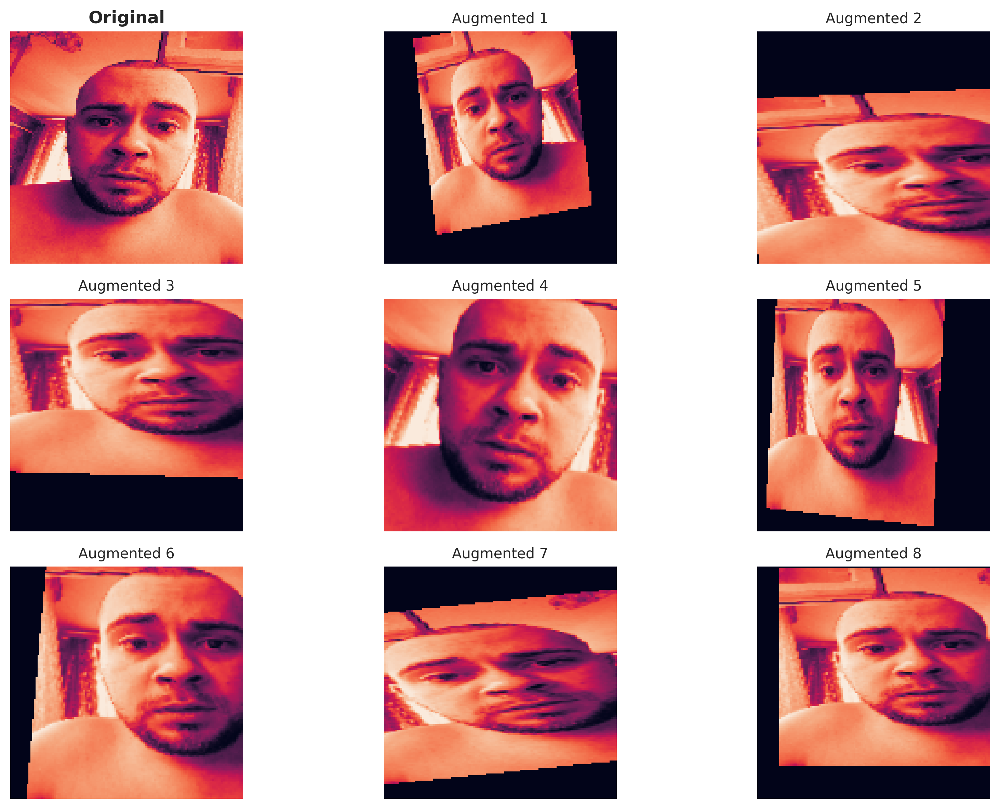

In [27]:
sns.set_style("whitegrid")
plt.rcParams['figure.dpi'] = 300

img_path = df.sample(n=1)['image_path'].iloc[0]
img = load_img(img_path, target_size=(IMG_SIZE, IMG_SIZE), color_mode='grayscale')
img_array = img_to_array(img) / 255.0

# Optimized augmentation for facial emotion recognition
# datagen = ImageDataGenerator(
#     rotation_range=8,           # Reduced from 20
#     width_shift_range=0.08,     # Reduced from 0.2
#     height_shift_range=0.08,    # Reduced from 0.2
#     shear_range=0.0,            # Removed - causes issues
#     zoom_range=0.5,    # Much smaller range than 0.5
#     horizontal_flip=True,
#     brightness_range=[0.8, 1.2],
#     fill_mode='reflect'         # Better than 'constant'
# )

datagen = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.1,
    zoom_range=0.5,
    horizontal_flip=True,
    fill_mode='constant'
)


img_array = np.expand_dims(img_array, axis=0)
aug_iter = datagen.flow(img_array, batch_size=1)

# Visualize original + augmented images
plt.figure(figsize=(12, 8))

# Show original
plt.subplot(3, 3, 1)
plt.imshow(img)
plt.title("Original", fontsize=12, fontweight='bold')
plt.axis('off')

for i in range(8):
    augmented = next(aug_iter)[0]
    plt.subplot(3, 3, i+2)
    plt.imshow(augmented)
    plt.title(f"Augmented {i+1}", fontsize=10)
    plt.axis('off')

plt.tight_layout()
plt.show()


## Step 4.1.6: Create augmented dataset


In [28]:
augmented_data = []

# Data augmentation setup matching model input (48x48 grayscale)
datagen = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.1,
    zoom_range=0.5,
    horizontal_flip=True,
    fill_mode='constant'
)

for idx, row in df.iterrows():
    img_path = row['image_path']
    # Ensure augmented images are also (IMG_SIZE, IMG_SIZE, 1)
    img = load_img(img_path, target_size=(IMG_SIZE, IMG_SIZE), color_mode='grayscale')
    img_array = img_to_array(img) / 255.0
    img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension for datagen

    aug_iter = datagen.flow(img_array, batch_size=1)

    for i in range(5):
        aug_img = next(aug_iter)[0] # Remove batch dimension to store as (height, width, channels)
        augmented_data.append({
            'set_id': row['set_id'],
            'gender': row['gender'],
            'age': row['age'],
            'country': row['country'],
            'emotion': row['emotion'],
            'image': aug_img, # Store as (48, 48, 1)
            'augmented': True
        })

# original_data = data_list # This line is incorrect and should be removed
all_data = original_data + augmented_data
all_df = pd.DataFrame(all_data)

# Split by set_id to prevent data leakage
unique_set_ids = df['set_id'].unique()
train_ids, test_ids = train_test_split(unique_set_ids, test_size=0.2, random_state=42, stratify=df.groupby('set_id')['emotion'].first())

train_df = all_df[all_df['set_id'].isin(train_ids)]
test_df = all_df[all_df['set_id'].isin(test_ids)]

print(f"\nOriginal dataset: {len(df)} images")
print(f"Augmented dataset: {len(augmented_data)} images")
print(f"Total dataset: {len(all_df)} images")
print(f"\nTrain set: {len(train_df)} images ({len(train_df)/len(all_df)*100:.1f}%)")
print(f"Test set: {len(test_df)} images ({len(test_df)/len(all_df)*100:.1f}%)")


Original dataset: 152 images
Augmented dataset: 760 images
Total dataset: 912 images

Train set: 720 images (78.9%)
Test set: 192 images (21.1%)


## Step 4.1.7: Train the Model

In [33]:
X_train = np.array(train_df['image'].tolist())
y_train = train_df['emotion'].values

X_test = np.array(test_df['image'].tolist())
y_test = test_df['emotion'].values

print(f"\nX_train shape: {X_train.shape}")  # (n, 128, 128, 1)
print(f"X_test shape: {X_test.shape}")      # (n, 128, 128, 1)

# Encode labels
le = LabelEncoder()
y_train_encoded = le.fit_transform(y_train)
y_test_encoded = le.transform(y_test)

y_train_cat = to_categorical(y_train_encoded, num_classes=len(EMOTIONS))
y_test_cat = to_categorical(y_test_encoded, num_classes=len(EMOTIONS))

# ============================================================================
# CONVERT GRAYSCALE TO RGB FOR VGG16
# ============================================================================

print("\n✓ Converting grayscale to RGB for VGG16...")

# Repeat grayscale channel 3 times to create "RGB"
X_train_rgb = np.repeat(X_train, 3, axis=-1)  # (720, 128, 128, 3)
X_test_rgb = np.repeat(X_test, 3, axis=-1)    # (192, 128, 128, 3)

print(f"✓ X_train_rgb shape: {X_train_rgb.shape}")  # Should be (720, 128, 128, 3)
print(f"✓ X_test_rgb shape: {X_test_rgb.shape}")    # Should be (192, 128, 128, 3)

# ============================================================================
# BUILD MODEL - VGG16 WITH RGB INPUT
# ============================================================================

from tensorflow.keras.applications import VGG16
from tensorflow.keras.models import Model
from tensorflow.keras.layers import GlobalAveragePooling2D

# Load VGG16 with ImageNet weights
base_model = VGG16(weights='imagenet', include_top=False,
                   input_shape=(IMG_SIZE, IMG_SIZE, 3))  # Changed to 3 channels

# Freeze base layers (don't train VGG16 weights initially)
for layer in base_model.layers:
    layer.trainable = False

# Add custom classifier
x = base_model.output
x = GlobalAveragePooling2D()(x)  # Better than Flatten for transfer learning
x = Dense(512, activation='relu')(x)
x = BatchNormalization()(x)
x = Dropout(0.5)(x)
x = Dense(256, activation='relu')(x)
x = Dropout(0.5)(x)
x = Dense(len(EMOTIONS), activation='softmax')(x)

model = Model(inputs=base_model.input, outputs=x)

# Use lower learning rate for transfer learning
from tensorflow.keras.optimizers import Adam
optimizer = Adam(learning_rate=0.0001)

model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])

print("\n✓ VGG16 transfer learning model built for RGB images")
model.summary()

# ============================================================================
# TRAIN MODEL
# ============================================================================

callbacks = [
    EarlyStopping(
        monitor='val_loss',
        patience=15,
        restore_best_weights=True,
        verbose=1
    ),
    ReduceLROnPlateau(
        monitor='val_loss',
        factor=0.5,
        patience=7,
        min_lr=1e-7,
        verbose=1
    ),
    ModelCheckpoint(
        '/content/working/best_emotion_vgg16.keras',
        monitor='val_accuracy',
        save_best_only=True,
        verbose=1
    )
]

print("\n" + "="*70)
print("TRAINING MODEL (VGG16 Transfer Learning)")
print("="*70)

history = model.fit(
    X_train_rgb, y_train_cat,  # Use RGB version
    validation_data=(X_test_rgb, y_test_cat),  # Use RGB version
    epochs=50,
    batch_size=16,  # Smaller batch for transfer learning
    callbacks=callbacks,
    verbose=1
)

# ============================================================================
# OPTIONAL: FINE-TUNE VGG16 (Unfreeze last few layers)
# ============================================================================

print("\n" + "="*70)
print("FINE-TUNING (Unfreezing last layers)")
print("="*70)

# Unfreeze last 4 layers of VGG16
for layer in base_model.layers[-4:]:
    layer.trainable = True

# Recompile with lower learning rate
optimizer_finetune = Adam(learning_rate=0.00001)
model.compile(optimizer=optimizer_finetune, loss='categorical_crossentropy', metrics=['accuracy'])

# Continue training
history_finetune = model.fit(
    X_train_rgb, y_train_cat,
    validation_data=(X_test_rgb, y_test_cat),
    epochs=20,
    batch_size=16,
    callbacks=callbacks,
    verbose=1
)

# ============================================================================
# INFERENCE WITH RGB WEBCAM (Convert to Grayscale)
# ============================================================================

import cv2

def predict_emotion_from_webcam(face_img_rgb, model, img_size=128):
    """
    Predict emotion from RGB webcam image
    Converts to grayscale for model input

    Args:
        face_img_rgb: RGB image from webcam (numpy array)
        model: Trained keras model
        img_size: Target size for model input

    Returns:
        emotion (str), confidence (float)
    """
    # Convert RGB to grayscale
    face_gray = cv2.cvtColor(face_img_rgb, cv2.COLOR_RGB2GRAY)

    # Resize
    face_resized = cv2.resize(face_gray, (img_size, img_size))

    # Normalize and reshape
    face_array = face_resized / 255.0
    face_array = np.expand_dims(face_array, axis=-1)  # Add channel dimension
    face_array = np.expand_dims(face_array, axis=0)   # Add batch dimension

    # Predict
    predictions = model.predict(face_array, verbose=0)
    emotion_idx = np.argmax(predictions[0])
    confidence = predictions[0][emotion_idx]

    return EMOTIONS[emotion_idx], confidence

# Example usage with webcam
"""
import cv2

cap = cv2.VideoCapture(0)
while True:
    ret, frame = cap.read()
    if not ret:
        break

    # Detect face (using Haar Cascade or MTCNN)
    # face_img = extract_face(frame)

    # Predict emotion
    emotion, confidence = predict_emotion_from_webcam(face_img, model)

    # Display
    cv2.putText(frame, f"{emotion}: {confidence:.2f}", (10, 30),
                cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)
    cv2.imshow('Emotion Detection', frame)

    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

cap.release()
cv2.destroyAllWindows()
"""

print("\n✓ Model ready for webcam inference (converts RGB to grayscale)")


X_train shape: (720, 128, 128, 1)
X_test shape: (192, 128, 128, 1)

✓ Converting grayscale to RGB for VGG16...
✓ X_train_rgb shape: (720, 128, 128, 3)
✓ X_test_rgb shape: (192, 128, 128, 3)

✓ VGG16 transfer learning model built for RGB images


Model: "functional_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_4 (InputLayer)      │ (None, 128, 128, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 (Conv2D)           │ (None, 128, 128, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, 128, 128, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, 64, 64, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, 64, 64, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, 64, 64, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, 32, 32, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, 32, 32, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, 32, 32, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, 32, 32, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, 16, 16, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, 16, 16, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, 16, 16, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, 16, 16, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, 8, 8, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, 8, 8, 512)      │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 (Conv2D)           │ (None, 8, 8, 512)      │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 (Conv2D)           │ (None, 8, 8, 512)      │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_pool (MaxPooling2D)      │ (None, 4, 4, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d        │ (None, 512)            │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_9 (Dense)                 │ (None, 512)            │       262,656 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_5           │ (None, 512)            │         2,048 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_9 (Dropout)             │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_10 (Dense)                │ (None, 256)            │       131,32

 Total params: 15,112,776 (57.65 MB)

 Trainable params: 397,064 (1.51 MB)

 Non-trainable params: 14,715,712 (56.14 MB)


TRAINING MODEL (VGG16 Transfer Learning)
Epoch 1/50
43/45 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - accuracy: 0.1064 - loss: 3.1446
Epoch 1: val_accuracy improved from -inf to 0.13542, saving model to /content/working/best_emotion_vgg16.keras
45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 40ms/step - accuracy: 0.1069 - loss: 3.1426 - val_accuracy: 0.1354 - val_loss: 2.1013 - learning_rate: 1.0000e-04
Epoch 2/50
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - accuracy: 0.1386 - loss: 2.7276
Epoch 2: val_accuracy did not improve from 0.13542
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.1382 - loss: 2.7294 - val_accuracy: 0.1302 - val_loss: 2.0917 - learning_rate: 1.0000e-04
Epoch 3/50
43/45 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - accuracy: 0.1591 - loss: 2.6360
Epoch 3: val_accuracy did not improve from 0.13542
45/45 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.1577 - loss: 2.6397 - val_accuracy: 0.0938 - val_loss: 2.0904 - learning_rate: 1.0000e-04
Epoch 4/50
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - accur

## Step 4.1.6: Problem with this dataset

**16.7% validation accuracy is terrible (barely better than random guessing for 8 classes which would be 12.5%).**  


The Core Problem: Our dataset is too small and imbalanced.

Looking at your training output:

- 720 training images across 8 emotion classes = ~90 images per class
- This is far too small for deep learning
- The model is not learning anything meaningful

# Phase 4 Dataset 2: Emotion Detection with FER2013

Given the challenges with the first dataset we had identified for the project, we decided to try a different dataset.

The FER2013 dataset: https://www.kaggle.com/datasets/msambare/fer2013

The data consists of 48x48 pixel grayscale images of faces. The faces have been automatically registered so that the face is more or less centred and occupies about the same amount of space in each image.

The task is to categorize each face based on the emotion shown in the facial expression into one of seven categories (0=Angry, 1=Disgust, 2=Fear, 3=Happy, 4=Sad, 5=Surprise, 6=Neutral). The training set consists of 28,709 examples and the public test set consists of 3,589 examples.

## Step 4.2.1: Downloading and Unzipping the Dataset

In [34]:
# Downloading and unzipping the dataset
!mkdir -p /content/datasets
!mkdir -p /content/datasets/fer2013_emotion

!curl -L -o /content/datasets/fer2013_emotion.zip https://www.kaggle.com/api/v1/datasets/download/msambare/fer2013

!unzip -o -q /content/datasets/fer2013_emotion -d /content/datasets/fer2013_emotion/

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
100 60.3M  100 60.3M    0     0  68.8M      0 --:--:-- --:--:-- --:--:--  171M


## Step 4.2.2: EDA: Emotion Dataset (FER2013)

We analyze the class balance (e.g. usually "Happy" has more images than "Disgust").

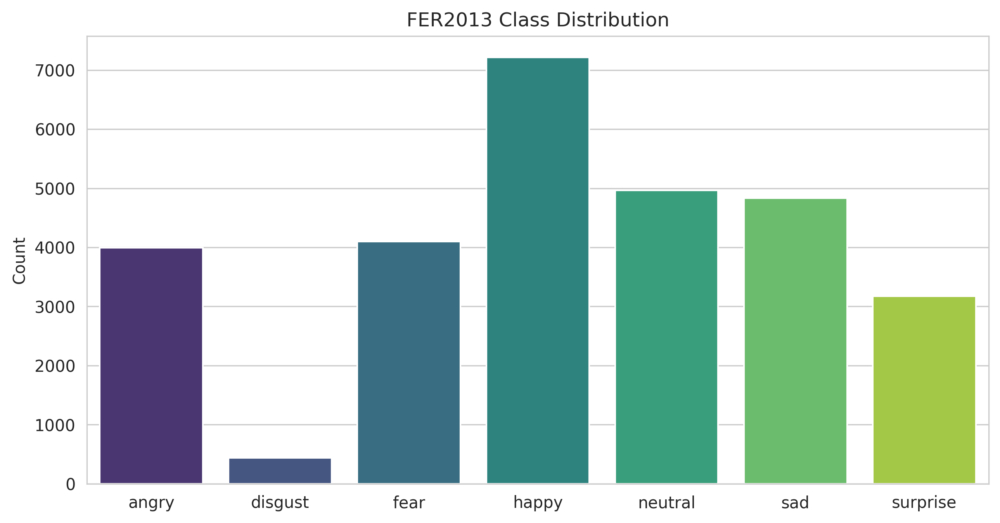

In [35]:
def check_emotion_distribution(root_dir):
    train_dir = os.path.join(root_dir, 'train')
    classes = sorted(os.listdir(train_dir))
    counts = []

    for c in classes:
        path = os.path.join(train_dir, c)
        counts.append(len(os.listdir(path)))

    plt.figure(figsize=(10, 5))
    sns.barplot(x=classes, y=counts, palette='viridis', hue=classes, legend=False)
    plt.title('FER2013 Class Distribution')
    plt.ylabel('Count')
    plt.show()

check_emotion_distribution('/content/datasets/fer2013_emotion')

-----

## Step 4.2.3: Modeling: Emotion Recognition (ResNet18)

We use Transfer Learning on the FER2013 dataset.

  * **Preprocessing Note:** FER2013 images are grayscale (48x48). ResNet expects RGB (224x224). We handle this in the `transforms` by converting grayscale to RGB.

<!-- end list -->

In [39]:
# 5.1 Define Transforms
# FER2013 is 48x48 Grayscale. We resize to 224x224 and replicate channels for ResNet.
data_transforms = {
    'train': transforms.Compose([
        transforms.Grayscale(num_output_channels=3), # Convert 1 channel -> 3 channels
        transforms.Resize((224, 224)),
        transforms.RandomHorizontalFlip(),
        transforms.RandomRotation(10),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
    'test': transforms.Compose([
        transforms.Grayscale(num_output_channels=3),
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
}

# 5.2 Load Data
data_dir = '/content/datasets/fer2013_emotion'
image_datasets = {x: ImageFolder(os.path.join(data_dir, x), data_transforms[x])
                  for x in ['train', 'test']}

dataloaders = {x: DataLoader(image_datasets[x], batch_size=32, shuffle=True, num_workers=2)
               for x in ['train', 'test']}

dataset_sizes = {x: len(image_datasets[x]) for x in ['train', 'test']}
class_names = image_datasets['train'].classes
print(f"Classes: {class_names}")

# 5.3 Define Model (ResNet18)
model_emotion = models.resnet18(pretrained=True)

# Freeze early layers
for param in model_emotion.parameters():
    param.requires_grad = False

# Replace final layer
num_ftrs = model_emotion.fc.in_features
model_emotion.fc = nn.Linear(num_ftrs, len(class_names))
model_emotion = model_emotion.to(device)

# 5.4 Training Loop
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model_emotion.fc.parameters(), lr=0.001)

def train_emotion_model(model, epochs=5):
    history = {'train_loss': [], 'train_acc': [], 'test_loss': [], 'test_acc': []}

    for epoch in range(epochs):
        print(f'Epoch {epoch+1}/{epochs}')

        for phase in ['train', 'test']:
            if phase == 'train':
                model.train()
            else:
                model.eval()

            running_loss = 0.0
            running_corrects = 0

            for inputs, labels in dataloaders[phase]:
                inputs = inputs.to(device)
                labels = labels.to(device)

                optimizer.zero_grad()

                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    _, preds = torch.max(outputs, 1)
                    loss = criterion(outputs, labels)

                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)

            epoch_loss = running_loss / dataset_sizes[phase]
            epoch_acc = running_corrects.double() / dataset_sizes[phase]

            print(f'{phase} Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}')
            history[f'{phase}_loss'].append(epoch_loss)
            history[f'{phase}_acc'].append(epoch_acc)

    return model, history

print("🚀 Starting Emotion Model Training...")
model_emotion, emotion_training_history = train_emotion_model(model_emotion, epochs=5) # Increase epochs for better accuracy


Classes: ['angry', 'disgust', 'fear', 'happy', 'neutral', 'sad', 'surprise']
Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth


100%|██████████| 44.7M/44.7M [00:00<00:00, 201MB/s]

🚀 Starting Emotion Model Training...
Epoch 1/5


train Loss: 1.6296 Acc: 0.3577
test Loss: 1.5923 Acc: 0.3872
Epoch 2/5
train Loss: 1.5474 Acc: 0.4018
test Loss: 1.5427 Acc: 0.4003
Epoch 3/5
train Loss: 1.5171 Acc: 0.4157
test Loss: 1.4996 Acc: 0.4250
Epoch 4/5
train Loss: 1.5117 Acc: 0.4169
test Loss: 1.4974 Acc: 0.4241
Epoch 5/5
train Loss: 1.5064 Acc: 0.4201
test Loss: 1.5701 Acc: 0.4149


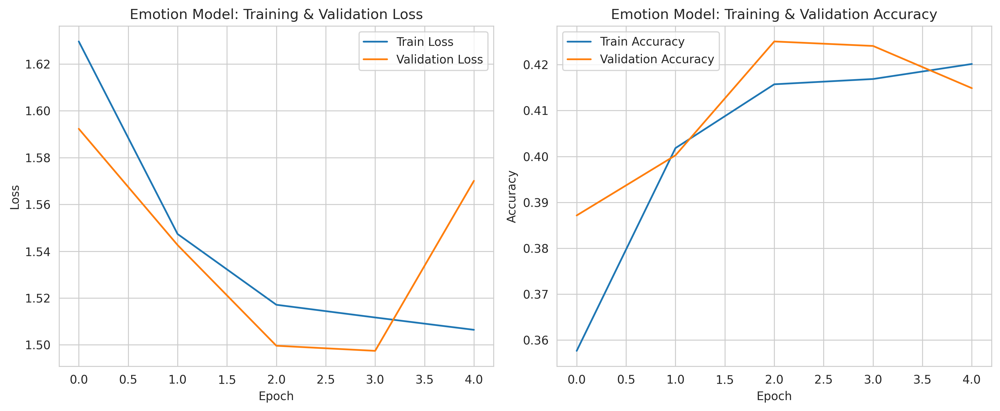

In [40]:
# Plotting training history
plt.figure(figsize=(12, 5))

# Extract CPU-bound numerical values for plotting
train_loss_cpu = [loss for loss in emotion_training_history['train_loss']]
test_loss_cpu = [loss for loss in emotion_training_history['test_loss']]
train_acc_cpu = [acc.cpu().item() for acc in emotion_training_history['train_acc']]
test_acc_cpu = [acc.cpu().item() for acc in emotion_training_history['test_acc']]

# Plot Loss
plt.subplot(1, 2, 1)
plt.plot(train_loss_cpu, label='Train Loss')
plt.plot(test_loss_cpu, label='Validation Loss')
plt.title('Emotion Model: Training & Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

# Plot Accuracy
plt.subplot(1, 2, 2)
plt.plot(train_acc_cpu, label='Train Accuracy')
plt.plot(test_acc_cpu, label='Validation Accuracy')
plt.title('Emotion Model: Training & Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

plt.tight_layout()
plt.show()

-----

## Step 4.2.4: Final Integration - Inference System

This is the "Final Product". It takes a random image from the test set, counts the people (YOLO), finds faces (Haar Cascade), and classifies their emotion.

**Why Haar Cascade?** YOLO detects bodies. FER2013 is trained on close-up faces. We use Haar Cascade to crop the face out of the body for the Emotion model to read.


0: 512x640 2 items, 12.1ms
Speed: 3.9ms preprocess, 12.1ms inference, 1.9ms postprocess per image at shape (1, 3, 512, 640)
Results saved to /content/results/predictions2
1344 labels saved to /content/results/predictions2/labels


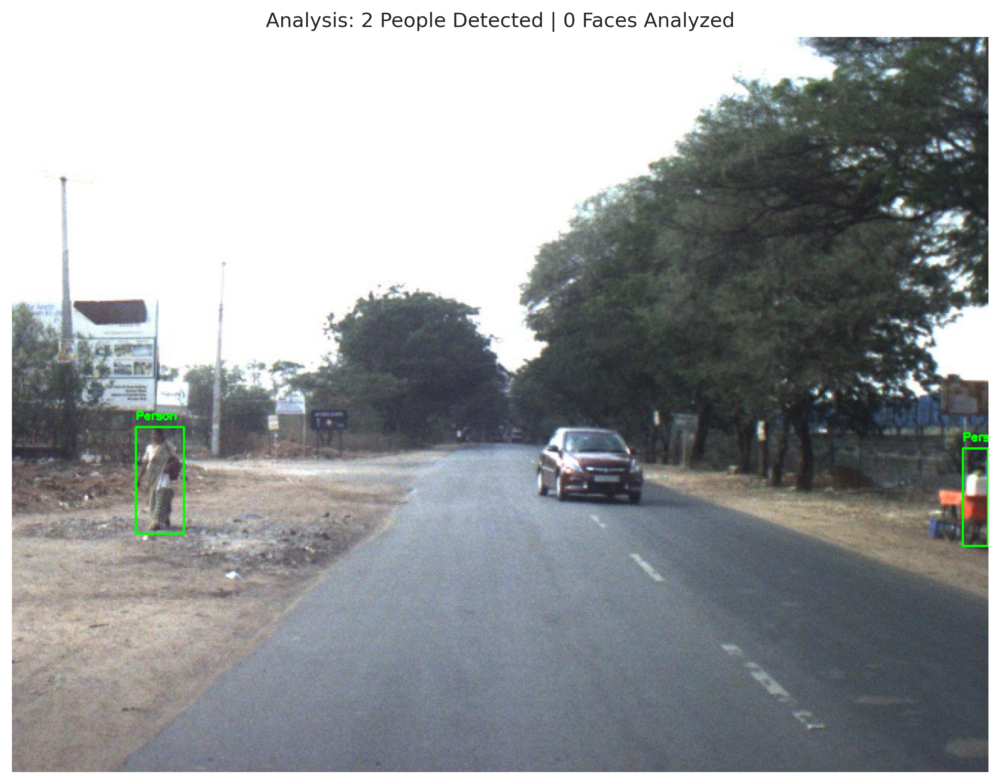


0: 480x640 9 items, 9.3ms
Speed: 2.2ms preprocess, 9.3ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)
Results saved to /content/results/predictions2
1344 labels saved to /content/results/predictions2/labels


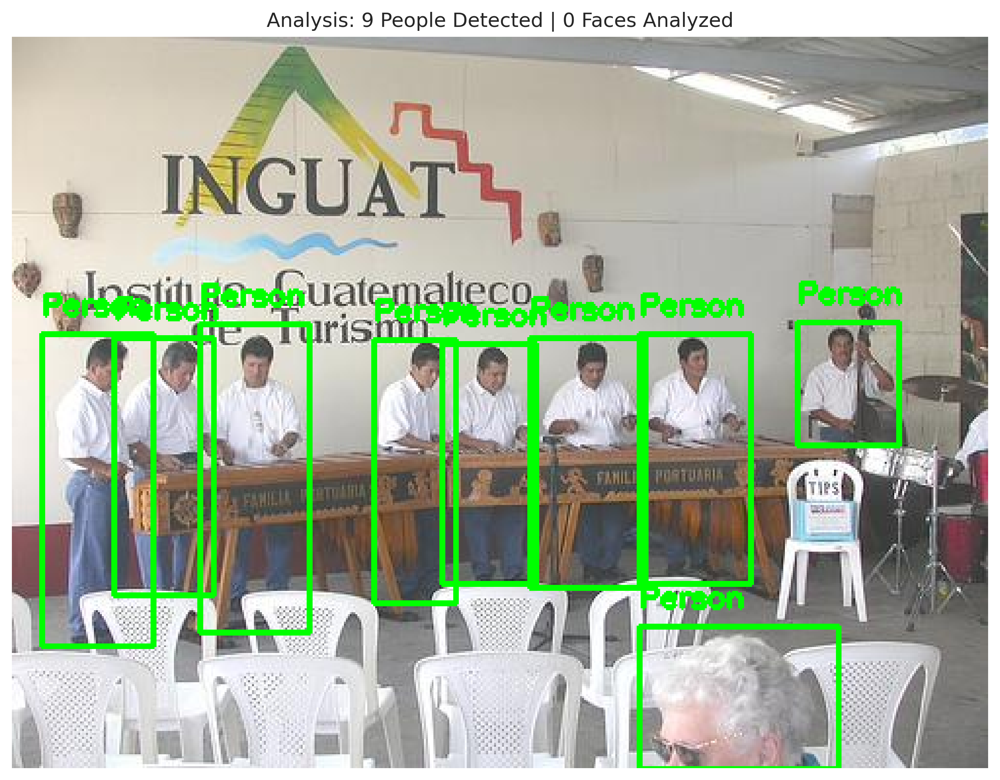

In [44]:
# Load Face Detector (OpenCV)
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

def analyze_scene(image_path):
    # 1. Read Image
    img = cv2.imread(image_path)
    if img is None: return
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # 2. People Detection (YOLO)
    # Detects bodies/people in the scene
    results =  best_model(img_rgb) #, verbose=False)
    people_boxes = results[0].boxes
    people_count = len(people_boxes)

    # Start drawing on a copy
    final_img = img_rgb.copy()

    # Draw YOLO Boxes (People)
    # We manually draw to control color (Green for People)
    for box in people_boxes:
        x1, y1, x2, y2 = map(int, box.xyxy[0])
        cv2.rectangle(final_img, (x1, y1), (x2, y2), (0, 255, 0), 2)
        cv2.putText(final_img, "Person", (x1, y1-10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    # 3. Emotion Recognition (Face Detection + Classification)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    faces = face_cascade.detectMultiScale(gray, scaleFactor=1.1, minNeighbors=5, minSize=(30, 30))

    model_emotion.eval()

    for (fx, fy, fw, fh) in faces:
        # Crop the Face
        face_roi = final_img[fy:fy+fh, fx:fx+fw]
        face_pil = PIL.Image.fromarray(face_roi)

        # Preprocess for ResNet
        face_tensor = data_transforms['test'](face_pil).unsqueeze(0).to(device)

        # Predict
        with torch.no_grad():
            outputs = model_emotion(face_tensor)
            probs = torch.nn.functional.softmax(outputs, dim=1)
            score, pred = torch.max(probs, 1)
            emotion = class_names[pred.item()]

        # Draw Face Box (Red for Emotion)
        # Only draw if probability is decent (>40%) to reduce noise
        if score.item() > 0.4:
            cv2.rectangle(final_img, (fx, fy), (fx+fw, fy+fh), (255, 0, 0), 2)
            label = f"{emotion} ({score.item():.2f})"
            cv2.putText(final_img, label, (fx, fy-10), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 0, 0), 2)

    # 4. Display
    plt.figure(figsize=(12, 8))
    plt.imshow(final_img)
    plt.title(f"Analysis: {people_count} People Detected | {len(faces)} Faces Analyzed")
    plt.axis('off')
    plt.show()

# Run on a sample image from the People Dataset test set
test_files = glob.glob('/content/datasets/people_detection_yolo/test/images/*.jpg')
if test_files:
    analyze_scene(test_files[0])
    analyze_scene(test_files[5]) # Try another one
else:
    print("No test images found.")

## Step 4.2.5: Final Test  

✅ Download complete.

0: 640x640 25 items, 7.7ms
Speed: 3.0ms preprocess, 7.7ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
Results saved to /content/results/predictions2
1344 labels saved to /content/results/predictions2/labels


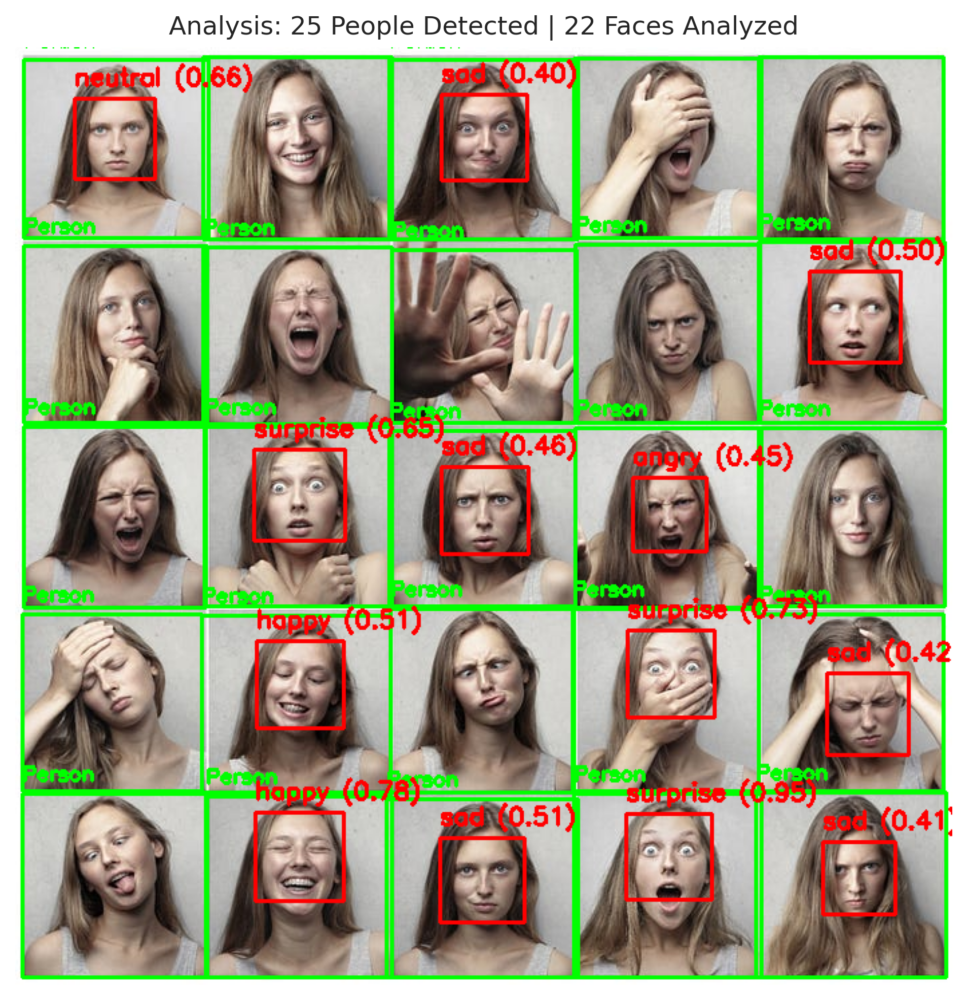

In [48]:
import requests

# 1. Download the image from the web
url = "https://miro.medium.com/v2/resize:fit:700/1*UghBE0Itc0NhXkbbMPKMRA.jpeg"
save_path = "custom_test_image.jpg"

print(f"Downloading image from {url}...")
response = requests.get(url)
with open(save_path, 'wb') as f:
    f.write(response.content)

print("✅ Download complete.")

# 2. Run Inference using your existing system
# This uses the models and function (analyze_scene) you created in Step 6
if 'analyze_scene' in globals():
    analyze_scene(save_path)
else:
    print("❌ Error: Please run the 'Step 6: Final Integration' code block first to define the analyze_scene function.")